In [3]:
import modneat
import os
import statistics
from IPython.display import display, Image
import modneat.visualize as visualize
import random
from PIL import Image as PILImage

In [5]:
def investigate_checkpoint(checkpoint_path, is_display=False):
    print(checkpoint_path)
    generation = int(checkpoint_path.split('-')[-1])
    generation += 1
    print('============================ infomation of ', generation, 'th generation ============================')
    populations = modneat.Checkpointer.restore_checkpoint(checkpoint_path)
    s = populations.species
    species_num = len(s.species)
    species_id_set = s.species.keys()
    print(species_id_set)
    #singleSpeciesObject = list(s.species.items())[0][1]
    #print(singleSpeciesObject.members)
    for sid in species_id_set:

        #print species info
        print(' >> species id: ', sid)
        print(' created: ', s.species[sid].created) #when the species was created
        print(' last improved: ', s.species[sid].last_improved)
        fitness_list = s.species[sid].get_fitnesses()
        print( sorted(s.species[sid].get_fitnesses(), reverse=True))
        members = s.species[sid].members
        member_list = list(s.species[sid].members.values())
        member_list.sort(key=lambda x: x.fitness, reverse=True)

        print('member_num: ', len(member_list))
        print('best_fitness: ', member_list[0].fitness)
        print('median_fitness: ', member_list[int(len(member_list)*0.5)].fitness)
        print('worst_fitness: ', member_list[-1].fitness)
        print('fitness_stddv: ', statistics.stdev(fitness_list))

        best_member = member_list[0]
        top25_member = member_list[int(len(member_list)*0.25)]
        median_member = member_list[int(len(member_list)*0.5)]
        top75_member = member_list[int(len(member_list)*0.75)]
        worst_member = member_list[-1]

        print(' number: ', len(members))
        tmp_img_dir = './cache/g' + str(generation) + '/s' + str(sid) + '/'
        for g in members.items():
            if not os.path.exists(tmp_img_dir):
                os.makedirs(tmp_img_dir)
            visualize.draw_net(config = populations.config, genome=best_member, view=False, filename=tmp_img_dir + 'best')
            visualize.draw_net(config = populations.config, genome=top25_member, view=False, filename=tmp_img_dir + 'top25')
            visualize.draw_net(config = populations.config, genome=median_member, view=False, filename=tmp_img_dir + 'top50')
            visualize.draw_net(config = populations.config, genome=top75_member, view=False, filename=tmp_img_dir + 'top75')
            visualize.draw_net(config = populations.config, genome=worst_member, view=False, filename=tmp_img_dir + 'worst')

        #Create a compiled image
        image_paths = [tmp_img_dir + 'best.png', tmp_img_dir + 'top25.png', tmp_img_dir + 'top50.png', tmp_img_dir + 'top75.png', tmp_img_dir + 'worst.png']
        images = [PILImage.open(x) for x in image_paths]
        widths, heights = zip(*(i.size for i in images))
        total_width = sum(widths)
        max_height = max(heights)
        new_im = PILImage.new('RGB', (total_width, max_height))
        x_offset = 0
        for im in images:
            new_im.paste(im, (x_offset,0))
            x_offset += im.size[0]
        new_im.save(tmp_img_dir + 'compiled.png')
    
        if(is_display):
            disp_imaege = tmp_img_dir + '/compiled.png'
            display(Image(disp_imaege))
            
#investigate_checkpoint('/home/ubuntu/Projects/modneat-python/tmp_test_learning/non_static_example/non_static_ModExHebbFFN_0/checkpoints/checkpoint-9', is_display=True)

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-9
============================ infomation of  10 th generation ============================
dict_keys([4, 2, 5, 1, 3, 6])
 >> species id:  4
 created:  0
 last improved:  6
[-5.701621796295305, -5.7370510795337735, -6.268967635641831, -6.320241714963193, -6.40495069599303, -6.456482562332292, -6.475237212414042, -6.497384136406033, -6.5143071016939285, -6.545170660319812, -6.583315261057318, -6.777795058908999, -6.9739326048522985, -7.5, -7.539572244051646, -7.625264362110855, -7.778378421620887, -7.861649731706584, -7.891427776768136, -7.935207220991894, -8.47196227865969, -8.989946634718045, -9.043919506552381, -9.667305157417307, -13.790485438121006, -17.812017141369857]
member_num:  26
best_fitness:  -5.701621796295305
median_fitness:  -7.5
worst_fitness:  -17.812017141369857
fitness_stddv:  2.6066329538836888
 number:  26


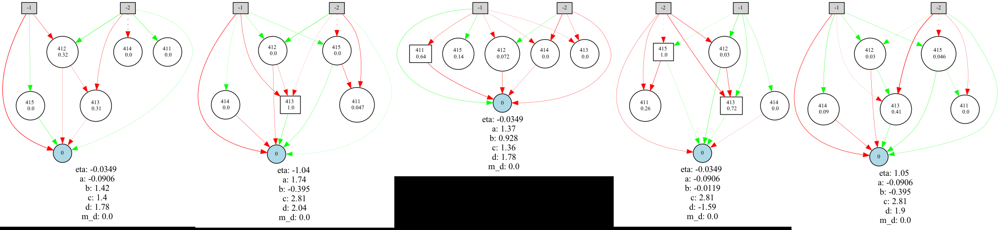

 >> species id:  2
 created:  0
 last improved:  6
[-4.773244585827185, -5.920491636679854, -5.9362541584170545, -5.9562945887983005, -6.013137588306151, -6.020197385542193, -6.07698004006966, -6.09933774577059, -6.180733354046332, -6.192877235020871, -6.210527051765028, -6.271485405411971, -6.422814119338849, -6.525723402487777, -6.700192743203243, -6.703410815697556, -6.827557524719072, -6.926061361978298, -7.272069173624464, -7.631180517801665, -7.699638562154118, -7.703072374290077, -7.741440187603987, -7.821552631765008, -7.844068354721507, -7.946634306477743, -9.28705313811508, -9.806184351227241, -9.870786976325412, -11.064073857000427, -12.716588251606339, -13.781606273053578]
member_num:  32
best_fitness:  -4.773244585827185
median_fitness:  -6.827557524719072
worst_fitness:  -13.781606273053578
fitness_stddv:  2.0325461614089315
 number:  32


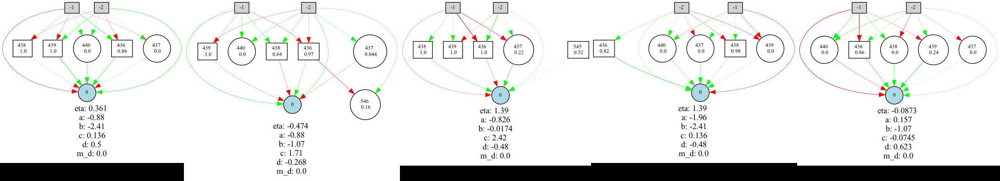

 >> species id:  5
 created:  3
 last improved:  7
[-3.0399397974939513, -3.979195768338056, -5.427744431158807, -5.6062429333197485, -5.698866770392589, -5.719211038592095, -5.914691818391582, -5.929672940994813, -5.987247435063969, -6.078153231377396, -6.229079748279398, -6.267456413668065, -6.278598942446745, -6.354324537739466, -6.757905283125845, -7.015260447859357, -7.491873107516899, -7.580570420870396, -7.809375425118404, -7.831829137363735, -7.8642808605062395, -7.869848366185912, -8.377616153707033, -9.05617557175631, -9.407957262324212, -9.812452734149163, -10.628188758472447, -13.675148825308298, -13.717937155276783, -13.726724888242664, -15.000806384150568]
member_num:  31
best_fitness:  -3.0399397974939513
median_fitness:  -7.015260447859357
worst_fitness:  -15.000806384150568
fitness_stddv:  2.909066035111247
 number:  31


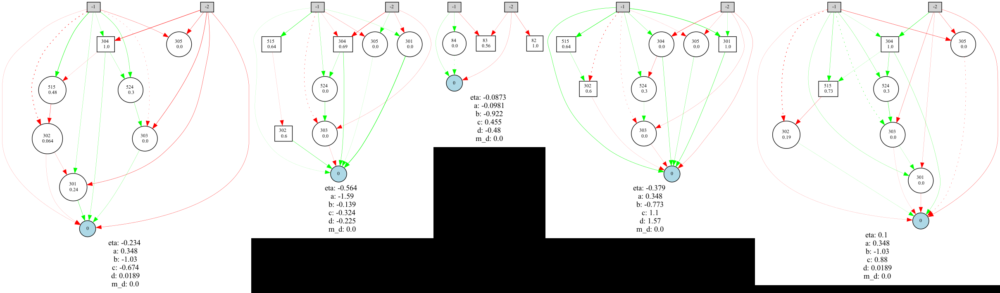

 >> species id:  1
 created:  0
 last improved:  6
[-3.9513807805506143, -4.998164083596647, -5.830441948339318, -6.380543812325042, -6.445627296806375, -6.454766113066979, -6.457182670635165, -6.581999771191513, -6.791631008630749, -6.904261583192554, -7.0558228999304795, -7.4363602927776675, -8.26242347870465, -8.654547144113273, -9.043067432742998, -10.364129688537076, -10.667384229505236, -13.141898339383342, -13.363398059010226, -13.470373453008028]
member_num:  20
best_fitness:  -3.9513807805506143
median_fitness:  -7.0558228999304795
worst_fitness:  -13.470373453008028
fitness_stddv:  2.762168138782353
 number:  20


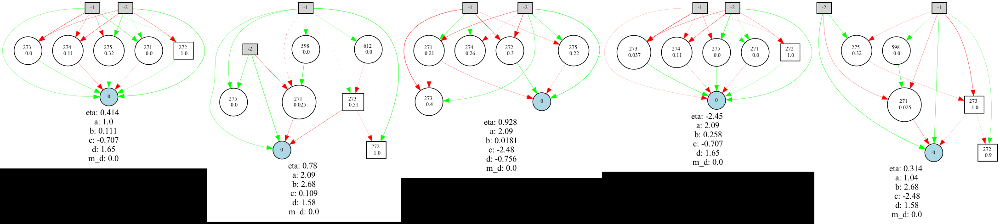

 >> species id:  3
 created:  0
 last improved:  1
[-3.476388674860426, -3.7470797272493246, -5.276550715314752, -5.318417251973681, -5.32285282532039, -5.7325028574487735, -6.078501299243893, -6.182920790749832, -6.212213573291005, -6.282967995891037, -6.341549846144811, -6.345802974641533, -6.548966701255159, -6.822306280001902, -6.945510146322404, -6.949339925978027, -6.955844060847736, -6.973951643097846, -7.2666803165516605, -7.288391574787131, -7.45290726786237, -7.899060052315679, -8.227385396480313, -9.045605948522152, -9.162939244355153, -9.265891422117255, -10.060059007382485, -10.44963733775684, -11.56628633094104, -11.605828858429808, -11.87112786125342, -13.66628187724939]
member_num:  32
best_fitness:  -3.476388674860426
median_fitness:  -6.955844060847736
worst_fitness:  -13.66628187724939
fitness_stddv:  2.3734068344678927
 number:  32


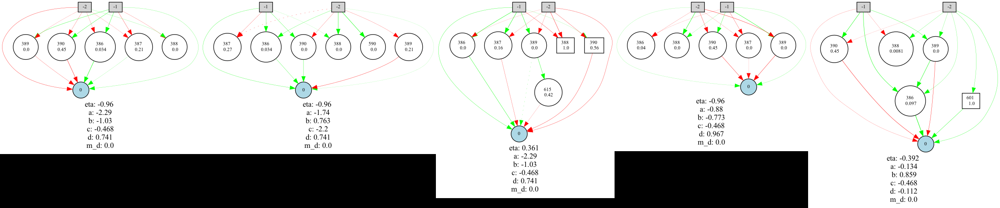

 >> species id:  6
 created:  8
 last improved:  8
[-5.747817972811293, -6.108848792455651, -6.112610534230102, -6.128277370626261, -6.194085171143168, -6.252409663433566, -6.256755283614222, -6.261947383465433, -6.271329938741265, -6.403487066940222, -6.677999949880362, -6.693850492302594, -6.706695648392893, -7.059219115599222, -7.150010056404952, -8.207782531263817, -9.170025828466716, -12.047071044164657, -13.306471900606432]
member_num:  19
best_fitness:  -5.747817972811293
median_fitness:  -6.403487066940222
worst_fitness:  -13.306471900606432
fitness_stddv:  2.0693438282524674
 number:  19


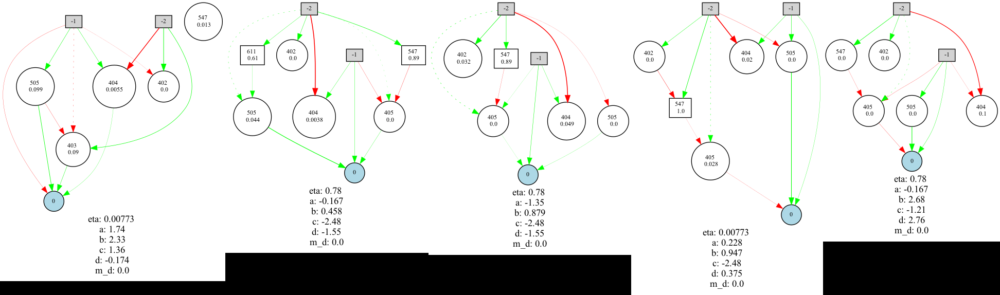

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-19
============================ infomation of  20 th generation ============================
dict_keys([4, 6, 1, 3, 5, 2])
 >> species id:  4
 created:  0
 last improved:  15
[-5.577255888647084, -5.770390345245415, -5.7888906508385585, -5.9167453660203835, -5.957921984702012, -5.974334610938026, -6.033932351807915, -6.03693620441141, -6.1826186376584, -6.195816150623612, -6.224360705740159, -6.330599415410113, -6.3420488260308785, -6.388534747790846, -6.393962160188236, -6.460492932741831, -6.495679317897106, -6.559504629849127, -6.833951538404528, -6.9349340872305145, -6.934970165403439, -7.238320183329439, -7.5, -7.500000000000001, -7.629547500008901, -7.879938157253819, -9.017509653666057, -9.779068566284048, -13.910629330961507]
member_num:  29
best_fitness:  -5.577255888647084
median_fitness:  -6.393962160188236
worst_fitness:  -13.910629330961507
fitness_stddv:  1

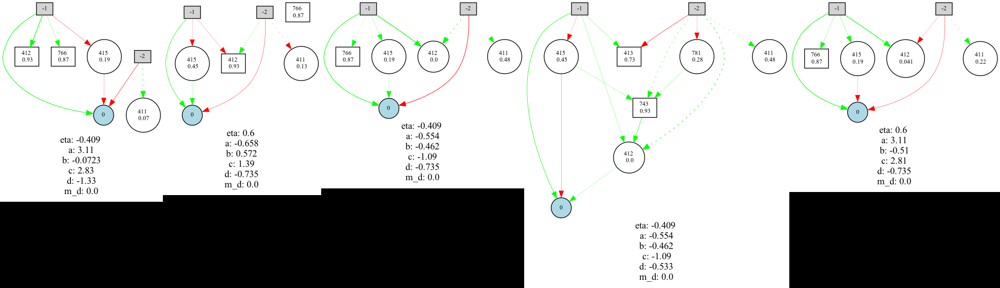

 >> species id:  6
 created:  8
 last improved:  10
[-5.353853857511368, -5.865683298258164, -5.866207438539121, -6.119567582206939, -6.142661512818329, -6.154742978886755, -6.471437197085186, -6.51463830650709, -6.610783207578178, -6.825087334967239, -7.231594913024564, -7.291179920178891, -7.473159795248572, -7.497164534107498, -7.7221475184592805, -7.73114383417218, -7.791436831004807, -7.839916978567089, -7.876255889092416, -7.880174149530489, -7.882581873428667, -7.892906443278209, -7.9126045335241555, -7.931953376345527, -7.955739009251132, -7.986590885126917, -8.20559377165016, -8.570689104381925, -8.801569758507538, -9.321064473755069, -9.532925932159014, -10.120023756665706, -10.895075744111685]
member_num:  33
best_fitness:  -5.353853857511368
median_fitness:  -7.791436831004807
worst_fitness:  -10.895075744111685
fitness_stddv:  1.2416588093451548
 number:  33


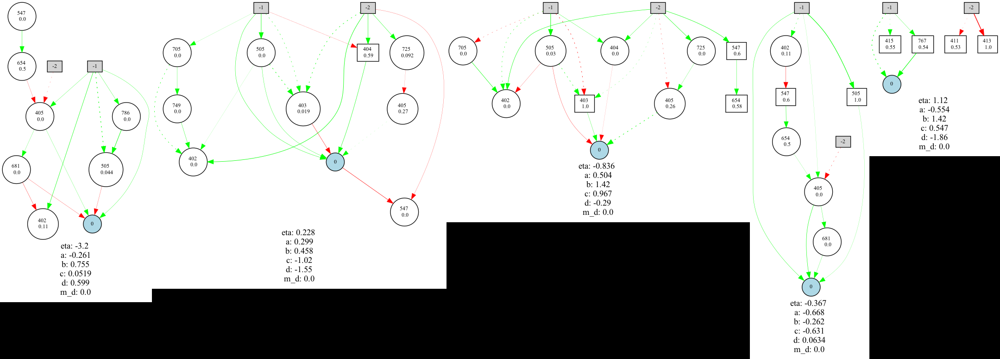

 >> species id:  1
 created:  0
 last improved:  6
[-4.508262241800515, -4.8941613928052625, -5.972777621595513, -6.002627273359613, -6.056097570030373, -6.12094431762183, -6.142485207890194, -6.167653163228097, -6.190531298245531, -6.218091942357237, -6.493690967991566, -6.543694518164706, -6.78255637363624, -6.889984280439526, -6.966634059307228, -7.033075690972669, -7.5, -7.762843924477773, -7.763363461588007, -7.805940473043375, -7.815339085743867, -7.8156104777819175, -7.860038403505699, -7.8783573425585915, -7.882683928529737, -8.723191814433688, -10.051793266494604, -10.05889734125466, -13.585299966857715, -13.71288627723995, -15.323367230463202, -15.78568539619732]
member_num:  32
best_fitness:  -4.508262241800515
median_fitness:  -7.5
worst_fitness:  -15.78568539619732
fitness_stddv:  2.8237338425102614
 number:  32


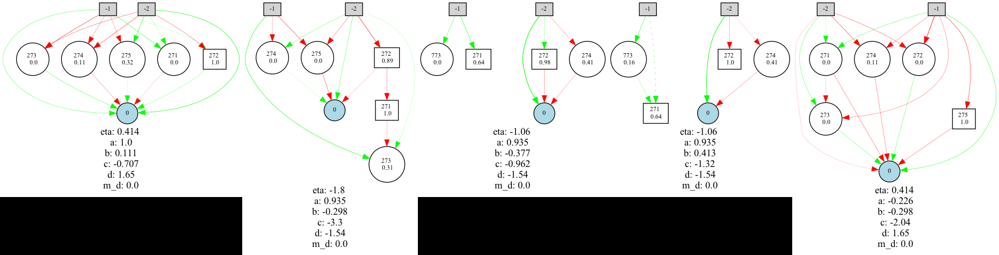

 >> species id:  3
 created:  0
 last improved:  1
[-3.154663678839921, -3.415220533431625, -5.646528555805205, -5.743361017237447, -6.72532887214588, -6.837809433295113, -6.899597629736058, -7.01746159265334, -7.499999999999999, -7.921252869693589, -8.017233017731463, -8.131020232487465, -8.20750278698222, -8.483745190616073, -8.879968258079234, -9.057459837835086, -9.12401577449843, -9.627353867894293, -10.758034953156221, -12.372776074197308, -12.426260410844348, -13.183704452639718, -13.49338763017542, -13.54774219654239, -13.550019957983972, -13.560169538313836, -13.687249465816016, -13.766185767095516, -14.883159506816249, -15.75451696902627, -16.90279221756885, -17.799228509647246]
member_num:  32
best_fitness:  -3.154663678839921
median_fitness:  -9.12401577449843
worst_fitness:  -17.799228509647246
fitness_stddv:  3.84135150995882
 number:  32


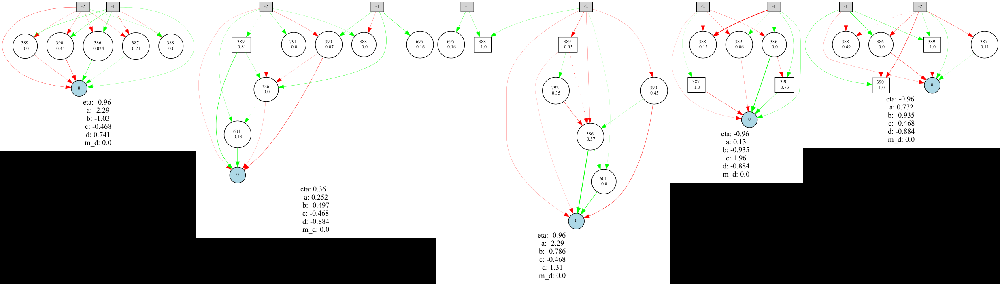

 >> species id:  5
 created:  3
 last improved:  10
[-3.0292047777204734, -3.935882134695635, -5.598881776224114, -5.7194461080992625, -6.048195088359373, -6.138437507450583, -6.197010647489015, -6.2008185639149405, -6.24635024702601, -6.4202608214512615, -6.435661720549814, -6.538255659821033, -6.743088761843942, -6.7529748937676235, -7.164799158854602, -7.193578149739707, -7.251355097423884, -7.338015813346632, -7.354958428855552, -7.5, -7.651114989510278, -7.692933144779936, -7.925582427651908, -7.942852939441226, -9.628802549319913, -9.647044468030003, -9.738319959408484, -10.47767184268947, -10.559349188940853, -11.516192015404972, -12.6467257127129, -13.371281817877382, -13.57325104965662, -13.661451282054605]
member_num:  34
best_fitness:  -3.0292047777204734
median_fitness:  -7.338015813346632
worst_fitness:  -13.661451282054605
fitness_stddv:  2.637017265877393
 number:  34


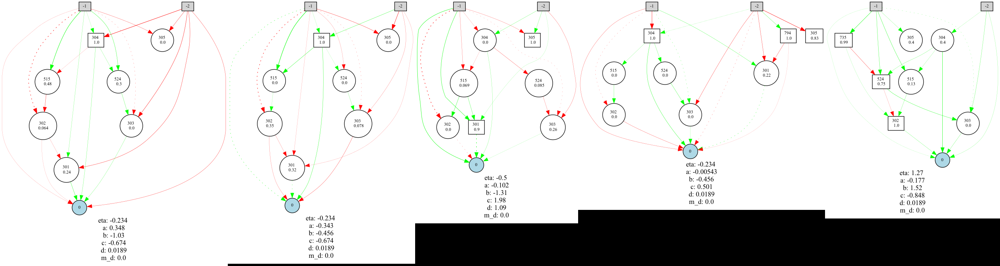

 >> species id:  2
 created:  0
 last improved:  18
[-2.787474728523109, -2.833582736450082, -4.297913540978274, -5.647572419915864, -5.773627097576573, -5.936206363518727, -6.056582850450086, -6.082062601663036, -6.204703384835055, -6.323172648650573, -6.335877278417799, -6.3397786899479955, -6.60271333495883, -6.697889358033867, -6.795834670125139, -7.154004598536472, -7.166306371346807, -7.4704609406271105, -7.5, -7.5, -7.5, -7.648030666166828, -7.702683873133931, -7.868565664881789, -8.19125987284186, -8.461105388930664, -8.582953422554647, -10.784028676848237, -11.495295187259698, -13.149920690583713, -13.397217840064506, -13.735900576766102]
member_num:  32
best_fitness:  -2.787474728523109
median_fitness:  -7.166306371346807
worst_fitness:  -13.735900576766102
fitness_stddv:  2.6041774225901397
 number:  32


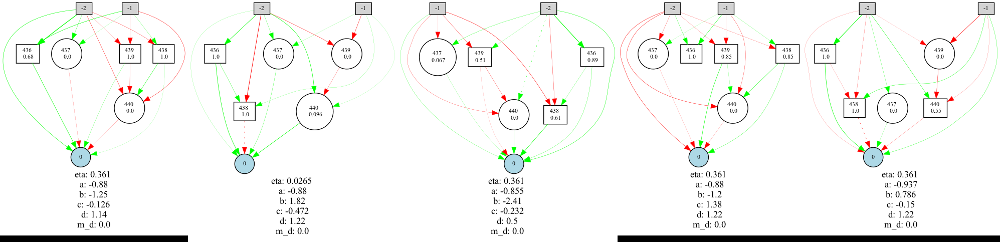

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-29
============================ infomation of  30 th generation ============================
dict_keys([6, 4, 1, 3, 5, 2])
 >> species id:  6
 created:  8
 last improved:  26
[-5.860482371433276, -5.958006024706001, -6.067351725792158, -6.08600859639019, -6.092327180979577, -6.1637341532038485, -6.224929726967489, -6.225612648341237, -6.226211191608581, -6.230195808920726, -6.251245387947766, -6.313235992912844, -6.318569704728671, -6.320232530217359, -6.327406594230177, -6.340732142385969, -6.4581077368630915, -6.542485186559384, -6.577844172821994, -6.697089378091693, -6.720018609235148, -6.875388418729582, -7.493297129891305, -7.748187583816529, -7.810585249181952, -7.850177910998611, -7.940668568221541, -9.632264816294432, -13.672051063088194]
member_num:  29
best_fitness:  -5.860482371433276
median_fitness:  -6.327406594230177
worst_fitness:  -13.672051063088194
fit

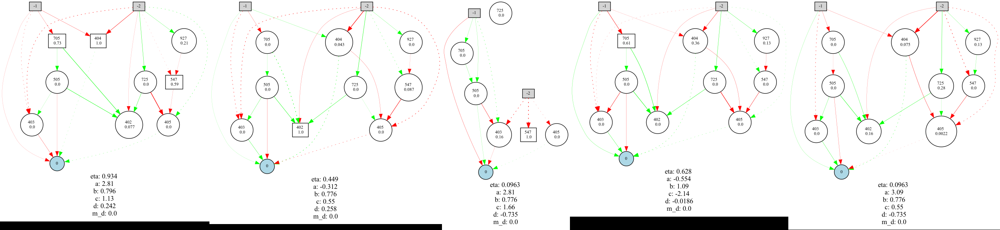

 >> species id:  4
 created:  0
 last improved:  15
[-5.436626968817899, -5.636541308357283, -5.77256329685367, -5.932052634190829, -5.992142618943574, -6.03967657281067, -6.043650694658547, -6.05667708402292, -6.07957523341899, -6.084444574038528, -6.098395682690852, -6.109527246897595, -6.140736428192646, -6.144895846612003, -6.168358717206831, -6.271023432320349, -6.314314756132546, -6.36997150352349, -6.416666434827978, -6.565485729061943, -6.570218084167312, -6.625372936400016, -6.650159683326275, -6.7555496216659225, -6.941614957534264, -6.981530527131408, -7.5, -7.5, -7.775350122788923, -7.817970476598851, -7.8319485745288935, -7.835291582225171, -7.920201363956375, -9.257032547015786, -9.351912861398029, -12.4718750923272, -13.40563307115933, -13.662679224367453, -13.685054979390491]
member_num:  39
best_fitness:  -5.436626968817899
median_fitness:  -6.565485729061943
worst_fitness:  -13.685054979390491
fitness_stddv:  2.220342695096005
 number:  39


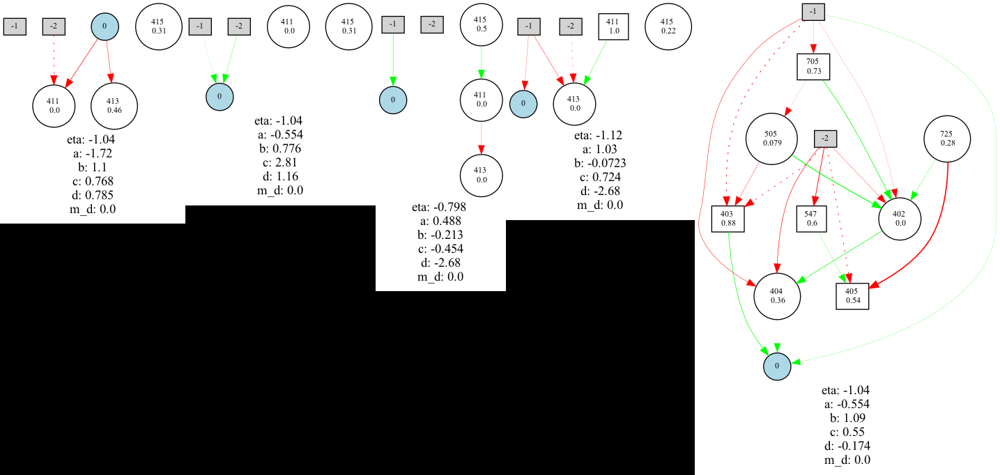

 >> species id:  1
 created:  0
 last improved:  6
[-4.278499607181588, -4.921573196508206, -5.986270338200249, -5.988985654928415, -6.097395997790034, -6.110672205718648, -6.120717551882287, -6.140229292785705, -6.150096752919953, -6.307235900415331, -6.3126895036219475, -6.370400231938515, -6.409418355491482, -6.4190089993562065, -6.503965413493136, -6.51431580155948, -6.611110895670844, -6.650634639652913, -6.708157857681684, -6.818512674833492, -6.853014531056529, -7.131068720140807, -7.5, -7.786761694000626, -7.826404608191863, -7.916403733864227, -8.023586095576457, -8.744559872626082, -11.919575454358684, -13.595796020828505, -13.74050794742053, -15.746398280273658]
member_num:  32
best_fitness:  -4.278499607181588
median_fitness:  -6.611110895670844
worst_fitness:  -15.746398280273658
fitness_stddv:  2.5933042413544722
 number:  32


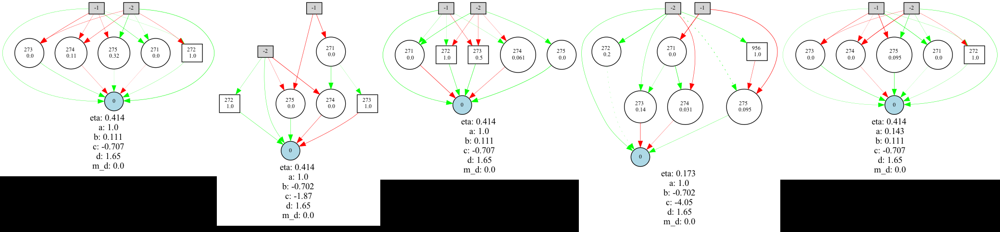

 >> species id:  3
 created:  0
 last improved:  26
[-3.609331479492752, -4.329105579325278, -5.897839936507447, -6.030366507614245, -6.108902092780831, -6.856174994525931, -7.029745275278239, -7.4410609558295455, -7.5, -7.804707352374152, -7.88856628593734, -7.896769207091757, -7.983213126627347, -7.996589015383497, -8.054766862049041, -8.076957093280893, -8.08137275495617, -8.638131727155832, -8.670247467283861, -8.943641986546176, -9.839599199518666, -11.757069218020986, -11.965778170750038, -12.654727668265313, -12.907561008967663, -13.241758633349761, -13.633091939291564, -13.887900329972926, -15.278250034894176, -16.938841555409326]
member_num:  30
best_fitness:  -3.609331479492752
median_fitness:  -8.076957093280893
worst_fitness:  -16.938841555409326
fitness_stddv:  3.266878971230835
 number:  30


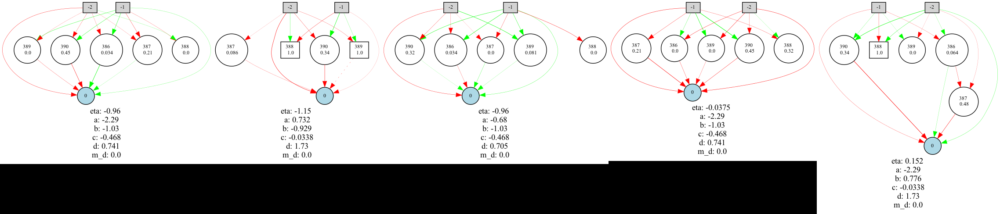

 >> species id:  5
 created:  3
 last improved:  24
[-2.9071610418323592, -3.3730431302896666, -5.8865556038598985, -5.908578025841132, -5.9948940631282035, -6.033954048056556, -6.044989632569705, -6.058781904342183, -6.196483934473525, -6.212939478038381, -6.513612988680834, -6.5395707500562406, -6.550184527674688, -6.617868058488521, -7.4589128509365965, -7.5, -7.500000000000001, -7.879186277864394, -7.906875208110077, -7.907875927114868, -8.801322440441355, -9.576838835237862, -9.660716722480513, -9.712785529061673, -9.995973288027322, -13.405773472112731, -13.511562084804368, -13.977028410253899, -16.83158539949513, -16.873148923711387]
member_num:  30
best_fitness:  -2.9071610418323592
median_fitness:  -7.5
worst_fitness:  -16.873148923711387
fitness_stddv:  3.4702649361930376
 number:  30


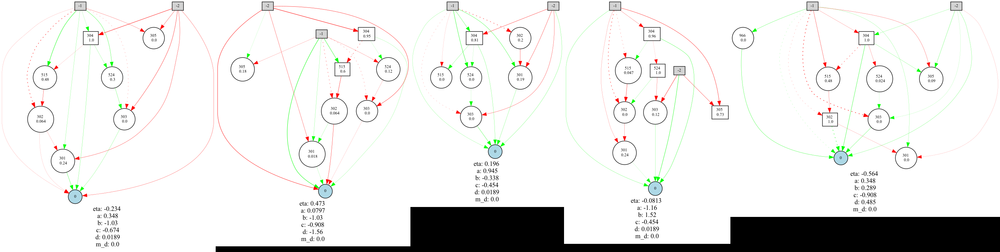

 >> species id:  2
 created:  0
 last improved:  27
[-2.5175801448231483, -2.7057604177804677, -4.510510999318427, -6.279398355993694, -6.5151397525907795, -6.577690028599074, -6.673041530325021, -6.794559872409199, -6.930207997820573, -7.516979247265537, -7.555457223909292, -7.792622152575265, -7.8615226301558865, -7.870710165126462, -7.907837387386065, -8.427510138492522, -8.995313562689297, -9.337934165195351, -9.464800768039789, -9.611940245091143, -9.638514047084039, -9.698178145141737, -9.801804432564843, -10.194578805519434, -11.645660692581433, -12.789289379633914, -13.550695725368666, -13.564970070366789, -13.771567439880952, -13.81798671103055, -16.352034383938868, -17.499995266268307]
member_num:  32
best_fitness:  -2.5175801448231483
median_fitness:  -8.995313562689297
worst_fitness:  -17.499995266268307
fitness_stddv:  3.5163476048622515
 number:  32


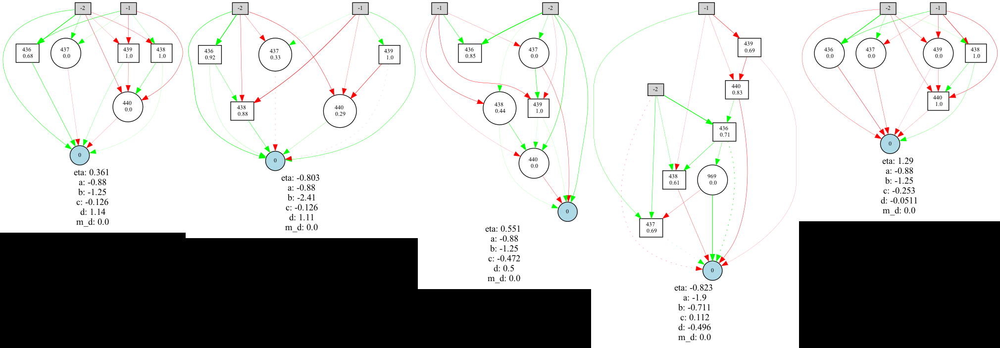

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-39
============================ infomation of  40 th generation ============================
dict_keys([4, 6, 1, 3, 5, 2])
 >> species id:  4
 created:  0
 last improved:  15
[-5.843610106665547, -5.938948552249731, -5.961195591902475, -6.0676188278002465, -6.095263275822421, -6.185657339002354, -6.2399171893526475, -6.255479191629149, -6.263980488123224, -6.274225614968301, -6.275649631777775, -6.282262611214449, -6.3094955115575395, -6.314382661827455, -6.317367504426338, -6.336543189872103, -6.342352205572828, -6.350885010061557, -6.3568698722743955, -6.357058966854582, -6.365725587839048, -6.394253042172067, -6.43160818306142, -6.466697193832318, -6.574416303233329, -6.869677355770859, -7.5, -7.641541432041745, -7.856960315628668, -7.866803887906597, -7.877133802167483, -7.908466668988825, -7.932240802723064, -7.958707389598372, -13.173309772365755]
member_num:  35
b

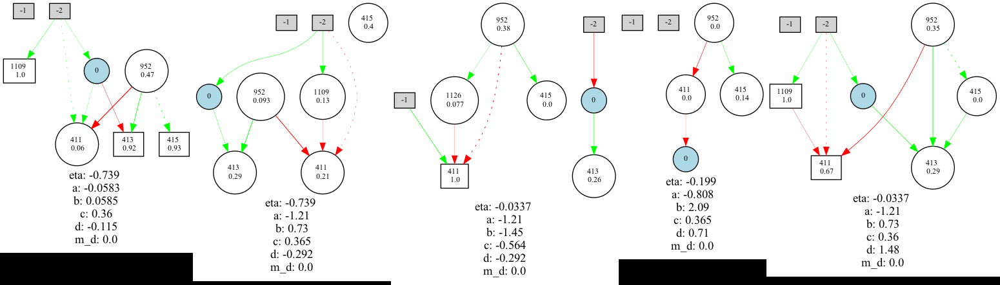

 >> species id:  6
 created:  8
 last improved:  35
[-5.784092821719647, -5.938948526199899, -5.988667364932907, -6.067485379250646, -6.207653774242012, -6.220328022996899, -6.274840614477996, -6.381215162034233, -6.442603259327851, -6.464818710469585, -6.887342626013673, -6.910264239802753, -7.019281416667679, -7.053526242325554, -7.5, -7.714170111728942, -7.795744721180437, -7.846675072815123, -7.857561847376823, -7.87740614892943, -8.385196088595773, -13.465797264985767, -13.60192414762637]
member_num:  23
best_fitness:  -5.784092821719647
median_fitness:  -6.910264239802753
worst_fitness:  -13.60192414762637
fitness_stddv:  2.0585063241350086
 number:  23


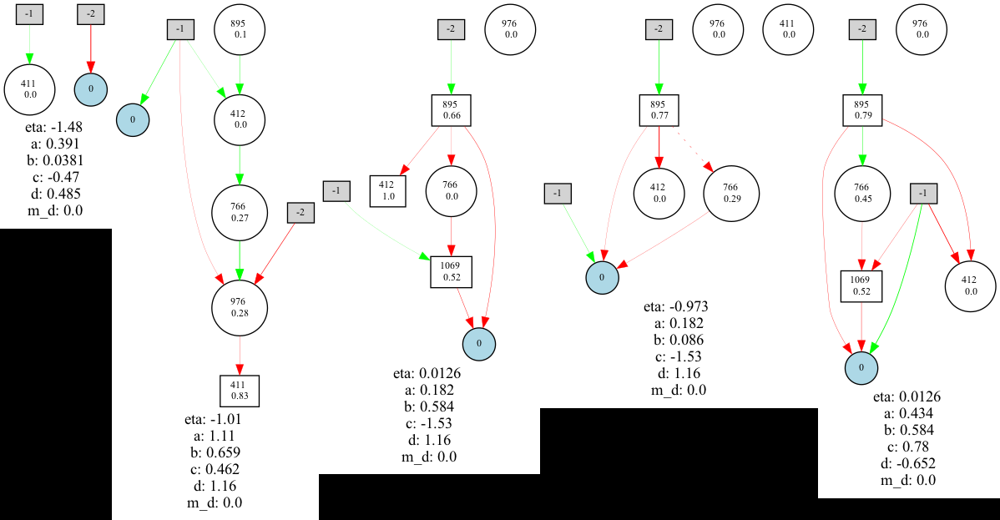

 >> species id:  1
 created:  0
 last improved:  6
[-4.058657445138981, -4.963916896306166, -5.975113495703091, -6.017105741873539, -6.043799974631376, -6.183993162567477, -6.20366922133532, -6.209210761196992, -6.235999024095598, -6.236852841456023, -6.258260668906317, -6.259510733307996, -6.281796645664483, -6.286416290508948, -6.328005180708411, -6.331606711665314, -6.348648656179365, -6.3910529720003675, -6.472881466048996, -6.636119024512187, -6.728857567521987, -7.178249670494429, -7.401111654886568, -7.5, -7.607425988194914, -7.695906472881936, -7.793610746811419, -7.828826988131614, -7.834296016277662, -7.990725836022118, -8.933223601773024, -9.207187127560209, -10.02093190273673, -13.348690972936897, -13.556348474507693, -16.643643266882567]
member_num:  36
best_fitness:  -4.058657445138981
median_fitness:  -6.472881466048996
worst_fitness:  -16.643643266882567
fitness_stddv:  2.469337378969418
 number:  36


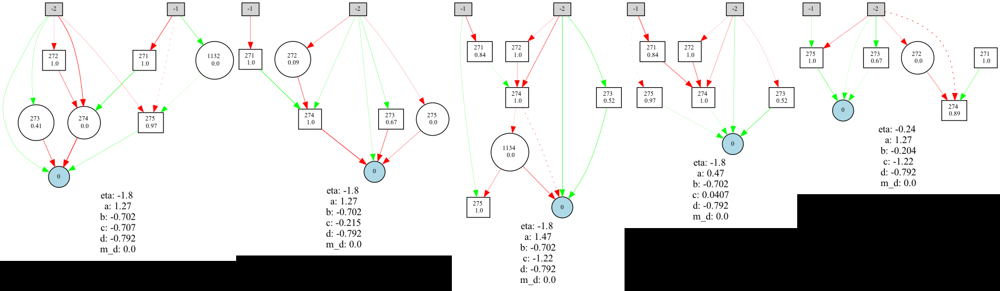

 >> species id:  3
 created:  0
 last improved:  26
[-3.759668789155504, -4.096129944914485, -4.667084570362024, -5.974650000648602, -6.067593645488433, -6.15008647227628, -6.243261288850367, -6.325654386233323, -6.407909996891156, -6.56660437716966, -6.688675075811489, -6.7231028296839614, -6.900956905158464, -6.934992942706454, -7.114955136661912, -7.293568357219777, -7.600873610839303, -7.832267266827193, -8.016618651184016, -8.608815706413335, -8.669806682383332, -8.881122525567573, -9.024781281745698, -9.230603846763128, -9.831118856218673, -11.054071372137544, -11.948640527993799, -13.141516345138456, -13.340273578630999, -14.137561925785326, -17.773943652329002]
member_num:  31
best_fitness:  -3.759668789155504
median_fitness:  -7.293568357219777
worst_fitness:  -17.773943652329002
fitness_stddv:  3.1155379992880157
 number:  31


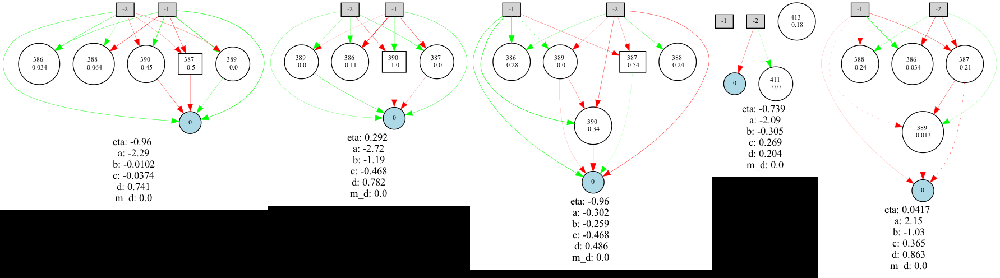

 >> species id:  5
 created:  3
 last improved:  32
[-3.0122935334821244, -3.266102906134554, -6.1397457787527605, -6.157964080367035, -6.237914995958417, -6.24496130269995, -6.501655656342868, -6.528189607891136, -6.580342481882651, -6.70500423485058, -6.746169603572255, -6.77395237258449, -6.843956967426177, -7.344251851333734, -7.444890180931781, -7.5, -7.544418372601292, -7.641863356841701, -7.700489819095013, -7.820801933514065, -7.830480028825519, -7.858982997160334, -7.881924581953513, -7.8904964418625125, -7.956351542109462, -7.967692674936955, -8.395973124541614, -8.623132741429268, -12.207558767368475, -12.27917534510457, -12.523028547198486, -12.793622066913878, -13.277542403805548, -13.53664482524491, -17.86414629398803, -17.88509143980676]
member_num:  36
best_fitness:  -3.0122935334821244
median_fitness:  -7.700489819095013
worst_fitness:  -17.88509143980676
fitness_stddv:  3.3692494373295334
 number:  36


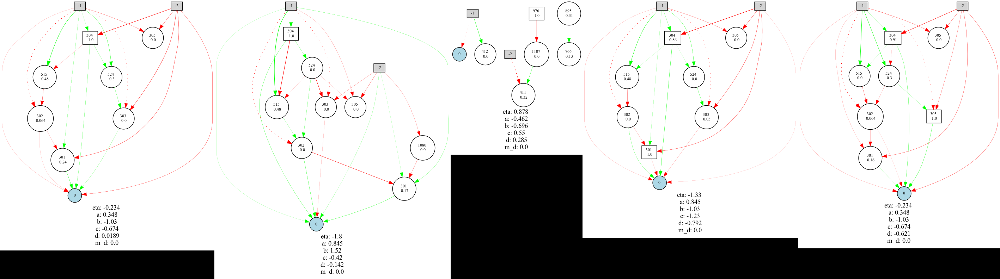

 >> species id:  2
 created:  0
 last improved:  27
[-2.197943547272037, -2.7483671493825894, -5.1204008424101755, -5.769513201272915, -6.021036350474272, -6.076634081806287, -6.114772759445342, -6.243783541636945, -6.279055894307662, -6.389018642337647, -6.692132942045459, -7.048347459681684, -7.420384000848056, -7.468084923341927, -7.525257876902848, -7.781246349840717, -7.846468112385215, -7.891566213869476, -7.979474992042012, -8.324221665637303, -8.606752922632035, -8.915301365463844, -9.296792572896683, -9.470986636213848, -9.823210996240867, -9.899261771233968, -9.901494291350557, -11.337096497397107, -12.72681810520267, -13.505110451545056, -14.256545846590651]
member_num:  31
best_fitness:  -2.197943547272037
median_fitness:  -7.781246349840717
worst_fitness:  -14.256545846590651
fitness_stddv:  2.686027354629754
 number:  31


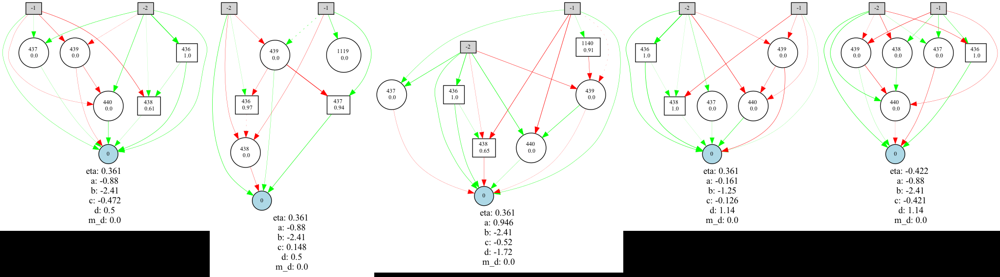

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-49
============================ infomation of  50 th generation ============================
dict_keys([6, 4, 3, 2, 5, 1])
 >> species id:  6
 created:  8
 last improved:  35
[-5.301888024858323, -6.230385514973134, -6.377954442144287, -6.5277253821791, -6.537409497183309, -6.563736066318469, -6.57486547725947, -6.862420753309009, -7.768491963715499, -7.8902564620398135, -9.178255303611394, -13.61854361344842]
member_num:  12
best_fitness:  -5.301888024858323
median_fitness:  -6.57486547725947
worst_fitness:  -13.61854361344842
fitness_stddv:  2.177656920631485
 number:  12


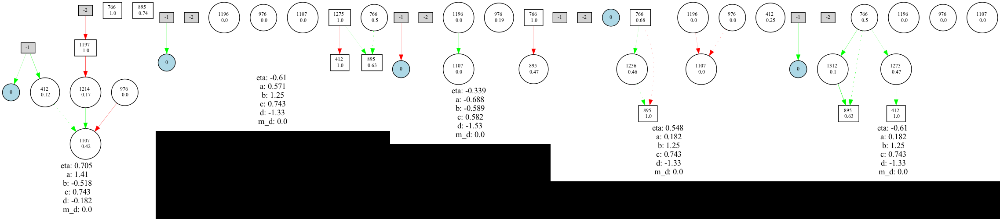

 >> species id:  4
 created:  0
 last improved:  15
[-5.513766433904182, -5.796502565753585, -5.922846052373936, -5.938948526199045, -6.072668406550418, -6.167842997851758, -6.176519405830618, -6.217200582195138, -6.219295112411847, -6.234261435345128, -6.2699851957524055, -6.29251269699729, -6.317243969775587, -6.324571010958787, -6.339569378231112, -6.350188679629297, -6.396705525416639, -6.756569792659002, -6.842754912815752, -6.856520878552758, -6.972563964037698, -7.04416630091892, -7.072505870767454, -7.1061473107180015, -7.1070145717290325, -7.5, -7.5, -7.505669412395079, -7.777712510085946, -7.854503619141442, -7.884405383200878, -7.889393587741601, -7.938693578029717, -8.05750103284491, -9.551243406978756, -9.68204181272963, -10.384387759900184, -11.27471484191273]
member_num:  38
best_fitness:  -5.513766433904182
median_fitness:  -6.856520878552758
worst_fitness:  -11.27471484191273
fitness_stddv:  1.2913633868363952
 number:  38


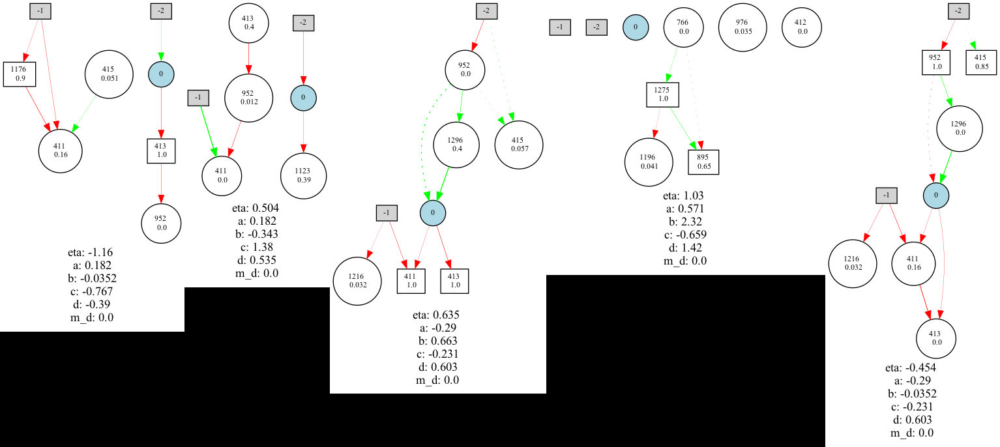

 >> species id:  3
 created:  0
 last improved:  26
[-3.378545781138846, -3.8686955203985067, -5.092348208625633, -5.338617108246002, -5.5861395212798435, -5.69295296953107, -6.027739783461203, -6.082235241180706, -6.086040228501268, -6.15380646872892, -6.167838595574649, -6.183033914731787, -6.197903470291501, -6.233204810087544, -6.281071342387358, -6.306717949905981, -6.408521302502002, -6.4406987361653885, -6.459380821286079, -6.567022274146017, -6.978549978695326, -6.978637745392735, -6.990929855096545, -7.120206880797355, -7.5, -7.5, -7.66443046388613, -7.692032980470115, -7.872198477274846, -7.975364888619055, -8.677980854125481, -8.683338112266998, -8.700888467146312, -8.742191808323753, -8.750819323487805, -8.842196586125844, -11.982063722102604]
member_num:  37
best_fitness:  -3.378545781138846
median_fitness:  -6.459380821286079
worst_fitness:  -11.982063722102604
fitness_stddv:  1.5519954984620012
 number:  37


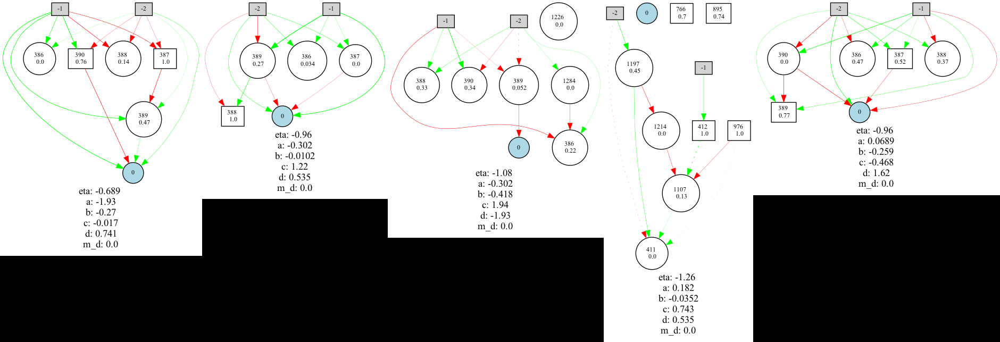

 >> species id:  2
 created:  0
 last improved:  39
[-2.3553137011905037, -3.044707459131795, -5.08913207791481, -5.229089516924433, -5.9408228034277295, -6.103760881417495, -6.173262301606985, -6.202094365031668, -6.212988736725039, -6.232064967337684, -6.246347390316709, -6.282993084035558, -6.3237789929206345, -6.327880121905953, -6.343367388072778, -6.541117105930982, -6.643179699529763, -6.709120467331061, -6.914919948508097, -6.957737439971466, -7.072580227710812, -7.248255461872967, -7.730134289252904, -7.79247955729881, -8.356103312873717, -8.460026133038628, -8.666944760969537, -9.42422386405962, -12.693004814828559, -12.995820663463983, -13.769315813858594]
member_num:  31
best_fitness:  -2.3553137011905037
median_fitness:  -6.541117105930982
worst_fitness:  -13.769315813858594
fitness_stddv:  2.4393847235853268
 number:  31


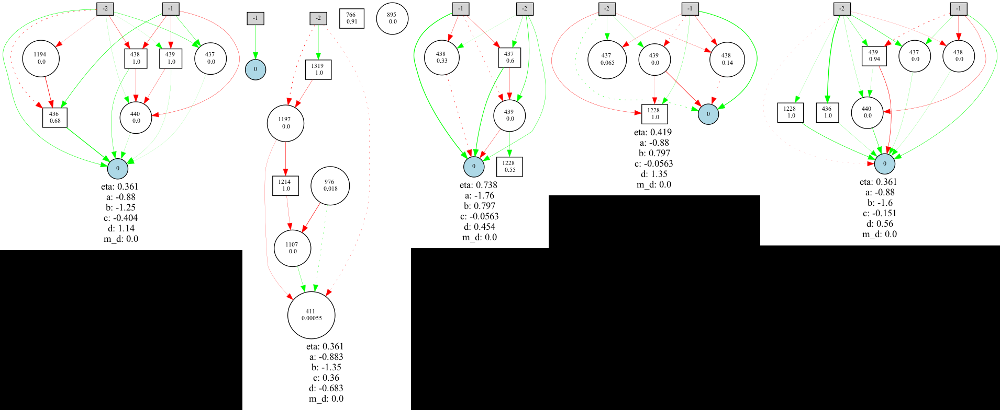

 >> species id:  5
 created:  3
 last improved:  42
[-1.7617801827100004, -2.9895269991869244, -3.51311349880074, -5.771135170610008, -6.010897792752857, -6.111582869164303, -6.206322639768296, -6.230706064408812, -6.285529634032819, -6.289041799159033, -6.302976352301587, -6.308350968067135, -6.32193994073797, -6.353610470259706, -6.370047727482537, -6.38770651553784, -6.492825717308358, -6.525826641546039, -6.538284524591881, -6.649678711281518, -6.708761433323754, -6.719608333336298, -6.772691276925725, -6.787882753725429, -6.790742600864417, -6.8995631979963274, -7.195283516952772, -7.715456802056636, -7.786731209465184, -7.871863899697929, -8.830218555654968, -9.222970329980837, -10.01820357866595, -10.401301357401849, -11.118710875930443, -12.185939484093803, -12.874956469248911, -13.57936147851308, -13.62237483535936, -17.49871882382366, -17.731263880803766, -17.878681532214824]
member_num:  42
best_fitness:  -1.7617801827100004
median_fitness:  -6.719608333336298
worst_fitness:

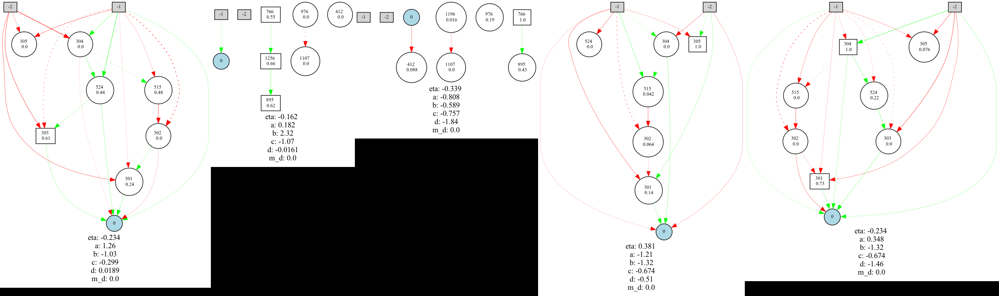

 >> species id:  1
 created:  0
 last improved:  48
[-2.23942312518297, -4.2258211255963785, -5.928436699057557, -6.064061565734422, -6.179723527120704, -6.349454502802964, -6.398277448259959, -6.430730127157826, -6.441110496693767, -6.480271534753733, -6.534278900167732, -6.610584228056933, -6.653151093838499, -6.685918071599312, -6.780536056789968, -7.243010972110605, -7.249218709003262, -7.5, -7.5, -7.764565255591893, -7.864864179632386, -7.871283736289481, -7.890210312404669, -7.947302021471506, -8.276072633117813, -8.443027140409132, -8.642544337247028, -8.911099578595453, -9.75852593332133, -10.586150803292915, -12.162984640276267, -13.294925673101691]
member_num:  32
best_fitness:  -2.23942312518297
median_fitness:  -7.249218709003262
worst_fitness:  -13.294925673101691
fitness_stddv:  2.0450960519829597
 number:  32


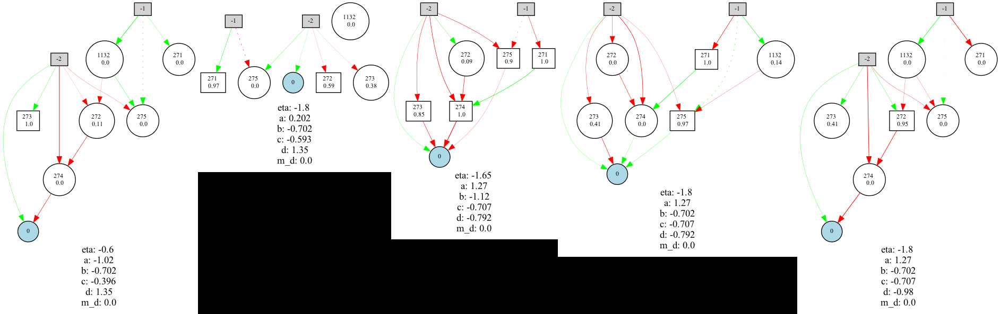

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-59
============================ infomation of  60 th generation ============================
dict_keys([6, 4, 3, 2, 5, 1])
 >> species id:  6
 created:  8
 last improved:  35
[-5.520160133092924, -5.738370247176982, -5.753290570141285, -5.858412569339878, -5.885417112324317, -6.103489231774536, -6.108499109670837, -6.121534350528007, -6.130756651577598, -6.164809948322924, -6.190579278712602, -6.221408653291033, -6.239590004806258, -6.278357565128583, -6.322846926640286, -6.338708282953311, -6.3651699453461505, -6.394309716979934, -6.425985151384363, -6.476368457423697, -6.554453896359095, -6.596946175532306, -6.74159150357985, -6.867975161123097, -6.944508214531325, -7.003423914578497, -7.0688555183213815, -7.328517720845445, -7.394836716119515, -7.438625988903205, -7.869937788919649, -12.447712765113552, -13.725335946872237, -13.825337613403521]
member_num:  34
best_fi

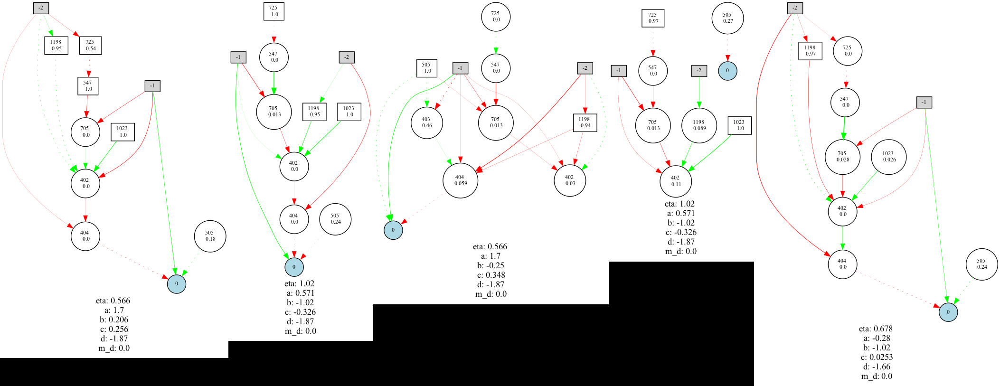

 >> species id:  4
 created:  0
 last improved:  15
[-5.758181726295177, -6.16219451216025, -6.204884051109262, -6.23045199049163, -6.233789482072378, -6.293285579219022, -6.3034953571145715, -6.345338745759728, -6.349252490614431, -6.420533016791431, -6.429345929507807, -6.442467935692777, -6.565652103574259, -6.677590860469377, -7.5, -7.795253456681857, -7.81250981127479, -7.950892557829483, -9.965578829235573, -12.7077406865182, -13.65361493924907]
member_num:  21
best_fitness:  -5.758181726295177
median_fitness:  -6.429345929507807
worst_fitness:  -13.65361493924907
fitness_stddv:  2.1396030667075028
 number:  21


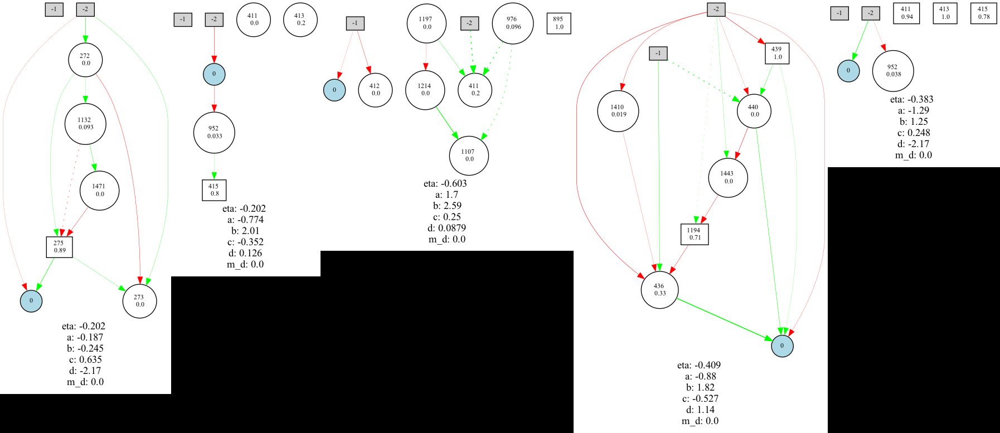

 >> species id:  3
 created:  0
 last improved:  55
[-2.827832084517797, -3.806169224398857, -5.34269266873625, -5.487610494089273, -5.6114795901341425, -5.9012023436095715, -6.009996419917613, -6.153114936796863, -6.194210685265855, -6.387562675730479, -6.424063737694633, -6.50066331848817, -6.628947858356724, -6.634217983561623, -6.6347571242243495, -6.722460411032964, -6.993437039957128, -7.220881265540314, -7.5, -7.638664485920186, -7.65901071245095, -7.753853326893402, -7.761445489696857, -7.773793713693979, -8.061229632712422, -8.117684103219378, -8.45297086204593, -8.635771326665191, -8.951893154851568, -10.156203947488967, -11.763926910813277, -13.346915337896895, -16.511164153570537]
member_num:  33
best_fitness:  -2.827832084517797
median_fitness:  -6.993437039957128
worst_fitness:  -16.511164153570537
fitness_stddv:  2.5526200766838945
 number:  33


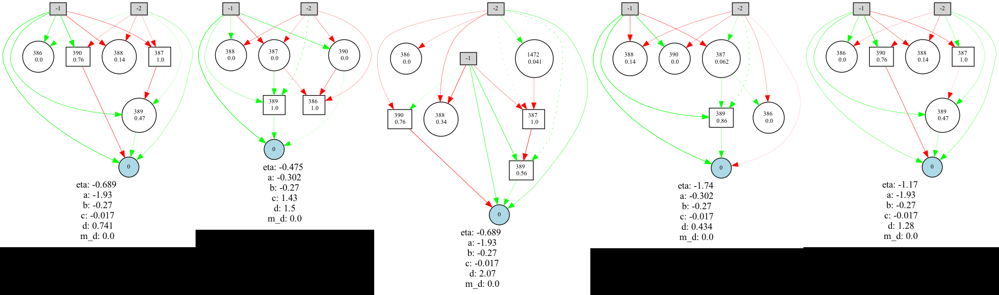

 >> species id:  2
 created:  0
 last improved:  55
[-2.2472291824110515, -2.9658485853108094, -3.090915028843043, -5.3271368527976755, -5.4375741486439635, -5.608570823894906, -6.175079535529292, -6.313544177772809, -6.333284788769544, -6.345617273565552, -6.345620501046977, -6.4505521152012815, -6.692403463213131, -6.701097334018729, -6.711477377342922, -6.745182326555644, -6.789135173913335, -6.9805305674615, -7.5, -7.823591150597921, -7.922367228442246, -7.974883561553561, -8.138197232359923, -8.349618384617887, -8.408946800867335, -9.001292390190699, -9.496036273601955, -9.513717569941086, -10.296878247675522, -13.40073101324455]
member_num:  30
best_fitness:  -2.2472291824110515
median_fitness:  -6.745182326555644
worst_fitness:  -13.40073101324455
fitness_stddv:  2.202165653276368
 number:  30


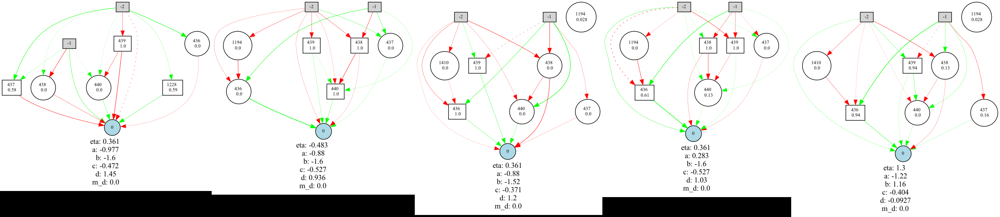

 >> species id:  5
 created:  3
 last improved:  49
[-2.8937028074208357, -2.962409439801284, -5.5879412886303435, -5.871341063781822, -5.937467748581051, -5.9502298265463525, -6.063601533727727, -6.174724719943939, -6.490542239155096, -6.682842905115347, -6.8672697725648515, -6.933339558005539, -6.960126879713548, -7.380925219556033, -7.416054313768807, -7.5, -7.5, -7.840530196271812, -7.918926832880417, -8.236180172380315, -8.315546159900137, -8.618373451801354, -8.620022360715609, -8.662983837025555, -8.671875517930937, -12.819267375094425, -13.373371785560206, -13.580191711436072, -13.768940708087639, -16.58304145264663, -16.70596078608107, -17.822489895274796]
member_num:  32
best_fitness:  -2.8937028074208357
median_fitness:  -7.5
worst_fitness:  -17.822489895274796
fitness_stddv:  3.754482885419337
 number:  32


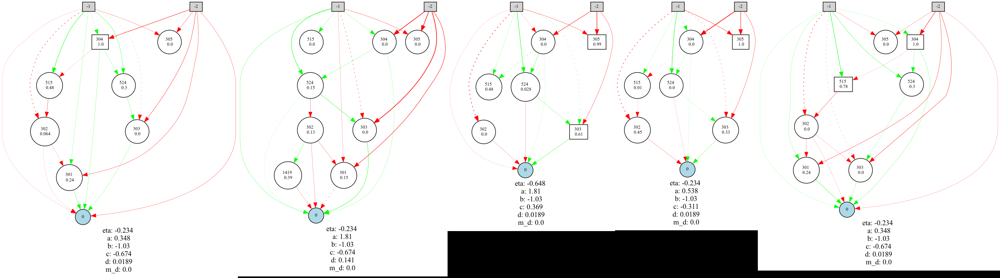

 >> species id:  1
 created:  0
 last improved:  48
[-2.0547906603052892, -3.4246269179957967, -3.7454504622649254, -5.7379855177688635, -5.794035454761448, -5.960835800823444, -6.003571850002039, -6.104658344476805, -6.165093429490681, -6.167079949040059, -6.272509819179749, -6.28591064784264, -6.401028037043635, -6.562236541512344, -6.750623980944143, -6.779825036591205, -6.78082150443344, -7.025984789911095, -7.5, -7.5, -7.5, -7.646643254803061, -7.726847642952775, -7.834018301364718, -8.336059379413712, -8.692147085752254, -9.015087738962514, -9.295977160183956, -9.326371766417468, -9.446541395115394, -9.523981253819825, -9.711035860280841, -10.161498687390697, -10.614608954678621, -13.566981631466305, -13.861837232274056, -14.22168250883573, -14.229640206990247, -14.4456322259115, -17.21830264417903, -17.601206445158745, -17.82230000930211]
member_num:  42
best_fitness:  -2.0547906603052892
median_fitness:  -7.646643254803061
worst_fitness:  -17.82230000930211
fitness_stddv:  3.75

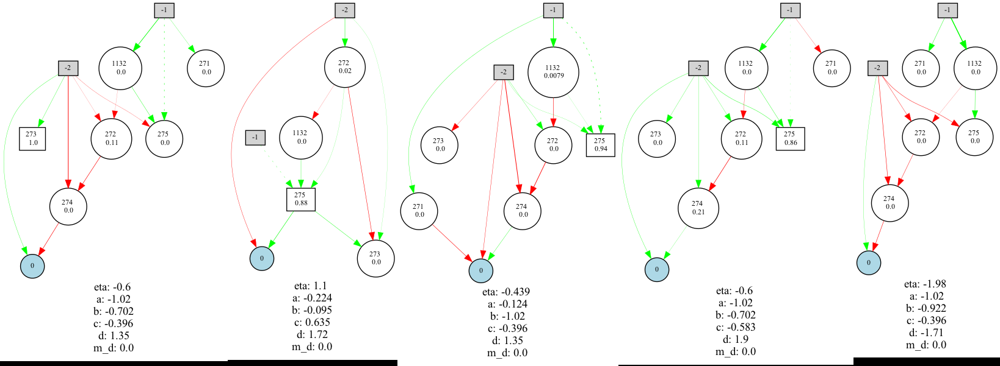

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-69
============================ infomation of  70 th generation ============================
dict_keys([6, 3, 2, 1, 5])
 >> species id:  6
 created:  8
 last improved:  35
[-5.8198025748682145, -5.937322162921751, -5.979956113935613, -6.034069933219512, -6.03407010496338, -6.119231165508983, -6.1534541472767295, -6.177726914759108, -6.299912310152728, -6.3604757872674424, -6.374678391058001, -6.378603755920367, -6.388082319303401, -6.409733725082823, -6.433874276438984, -6.468199364087636, -6.471958078225495, -6.510740549553951, -6.632745312783957, -6.741792021525951, -7.11504762524841, -7.281558483368815, -7.5, -7.583045917697955, -7.655832636692615, -7.711731156544609, -7.766533457880657, -7.7667672039367925, -7.989261704010401, -8.19846253315684, -10.244723700582911, -10.998485854038723, -13.559667130651649]
member_num:  33
best_fitness:  -5.8198025748682145
median_fi

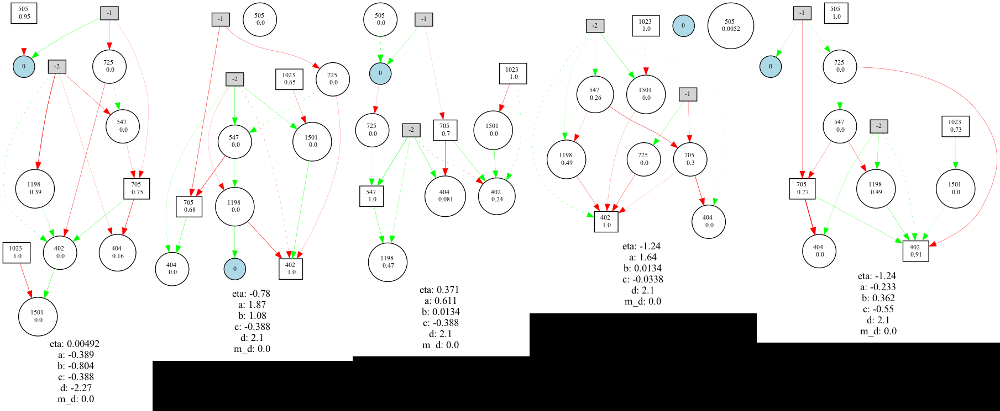

 >> species id:  3
 created:  0
 last improved:  55
[-2.848806978088107, -3.522508196093507, -4.177792176286241, -4.8239815170434195, -4.849839744384724, -4.980586727755477, -5.689169364367985, -6.06983562932875, -6.209392382944367, -6.319476873053295, -6.433030885576187, -6.649855949997705, -6.76078319722361, -7.519680572356728, -7.5501948364160185, -7.7923517101739534, -7.9654664847423104, -7.99828796412754, -8.099448939351564, -8.142118310376137, -8.486578622994692, -8.509381338405278, -8.917401430512312, -9.230637337784835, -9.555383930472615, -9.83728117448004, -10.478175129288843, -10.812456900100464, -11.139286075512628, -12.456175657918893, -13.457928210679963, -17.883443315414166]
member_num:  32
best_fitness:  -2.848806978088107
median_fitness:  -7.9654664847423104
worst_fitness:  -17.883443315414166
fitness_stddv:  3.066980729451599
 number:  32


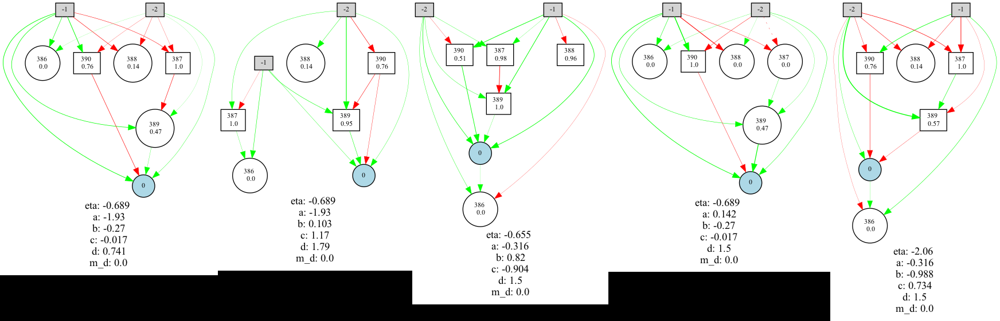

 >> species id:  2
 created:  0
 last improved:  67
[-2.2856561761175653, -2.3267492630080238, -5.816830057323493, -5.85930460249877, -6.006989715284619, -6.07527538487892, -6.175177943111992, -6.202581101448023, -6.235469727081431, -6.274530255852147, -6.377987418960171, -6.395860561914349, -6.436564315880975, -6.75571819110426, -6.8344340189249495, -7.027499248566509, -7.478612948998499, -7.5, -7.731923078073315, -7.747235646740499, -7.747591226766732, -7.748292724932044, -7.83646152592348, -7.84778247529519, -7.857147394479301, -7.8656054062694505, -7.876775655756236, -7.9222880347353115, -7.940347954596324, -7.946027136867551, -9.543662189994734, -9.698727638717497]
member_num:  32
best_fitness:  -2.2856561761175653
median_fitness:  -7.478612948998499
worst_fitness:  -9.698727638717497
fitness_stddv:  1.5525394454455277
 number:  32


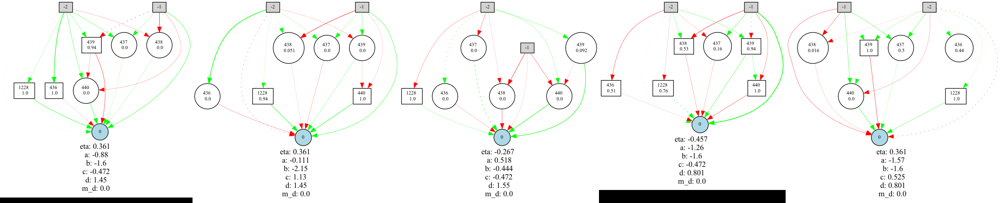

 >> species id:  1
 created:  0
 last improved:  68
[-2.2410900922564965, -2.903654657799869, -5.46923125735904, -5.526980660418631, -5.579651549033596, -5.738351780663689, -5.8365550154420935, -5.880146827493247, -5.880694450605357, -5.927106083223137, -5.995474782669547, -6.027448803225358, -6.076571198939611, -6.094094421742443, -6.2457230488098805, -6.3210506332078875, -6.355052511212852, -6.359302244754325, -6.446396188510609, -6.45545886394094, -6.4621320277871055, -6.517532462218428, -6.549396756791488, -7.5, -7.746423816118957, -7.867862797307629, -9.133466762933862, -9.791967112082853, -10.188494554954023, -10.193070284073746, -13.500258571226572, -15.005831869340346]
member_num:  32
best_fitness:  -2.2410900922564965
median_fitness:  -6.355052511212852
worst_fitness:  -15.005831869340346
fitness_stddv:  2.5399314833629485
 number:  32


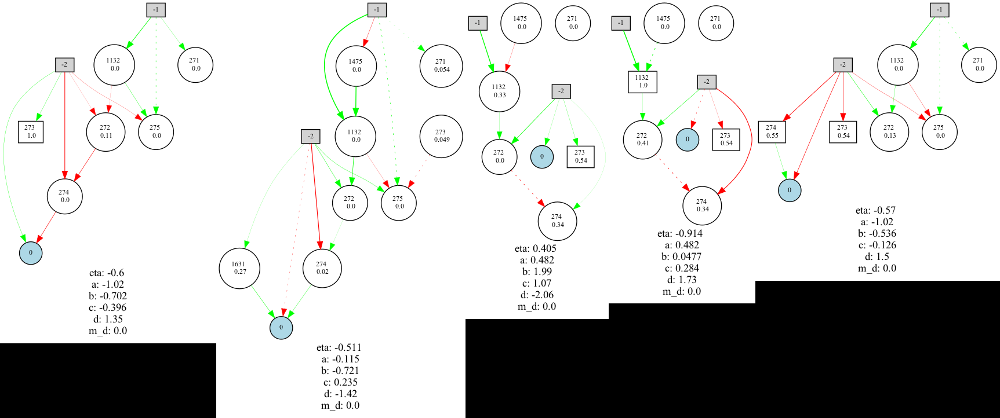

 >> species id:  5
 created:  3
 last improved:  49
[-3.0054868551744596, -3.13811506044995, -3.8243753254867334, -5.6031289135679785, -6.034072013643694, -6.389538732628862, -6.722238439860811, -7.176291207305555, -7.301084968567436, -7.450677499491187, -7.5, -7.5, -7.797401471564751, -7.803767022488176, -7.85723106501769, -7.866258460410989, -7.877684347898434, -7.8789834797795795, -7.88349634068057, -7.946686604760646, -8.12643518133173, -8.253456920912297, -8.36516014203839, -9.607187848494418, -9.74617901826216, -9.879721142428274, -10.35360715502951, -11.34414764815275, -13.19953718667046, -13.560589116799756, -17.921752432413236]
member_num:  31
best_fitness:  -3.0054868551744596
median_fitness:  -7.866258460410989
worst_fitness:  -17.921752432413236
fitness_stddv:  2.96053975314421
 number:  31


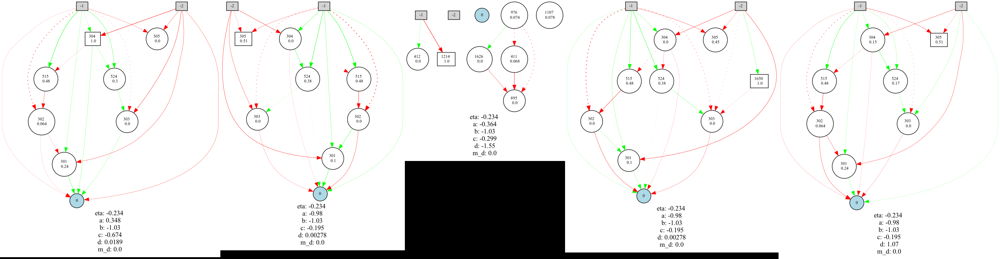

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-79
============================ infomation of  80 th generation ============================
dict_keys([6, 3, 5, 2, 1])
 >> species id:  6
 created:  8
 last improved:  35
[-5.217865055594962, -5.499777600832031, -5.575234743003942, -5.681961132921934, -5.711774049292365, -5.7913796998983855, -5.985295168375994, -6.056015055518856, -6.115156170139319, -6.122026522371403, -6.188883437362181, -6.189461252624077, -6.256350126049955, -6.396850200520616, -6.406065094563395, -6.478739640235407, -6.485820949368846, -6.584114782573586, -6.73020295108635, -6.944118623151794, -6.944119172793229, -7.26466912565906, -7.39386090774538, -7.395041470733027, -7.405665583858799, -7.51536385042262, -7.642631822314871, -7.781605570462636, -7.894154330654627, -7.915356656304142, -7.995072158951026, -13.670785726268962]
member_num:  32
best_fitness:  -5.217865055594962
median_fitness:  -6.48

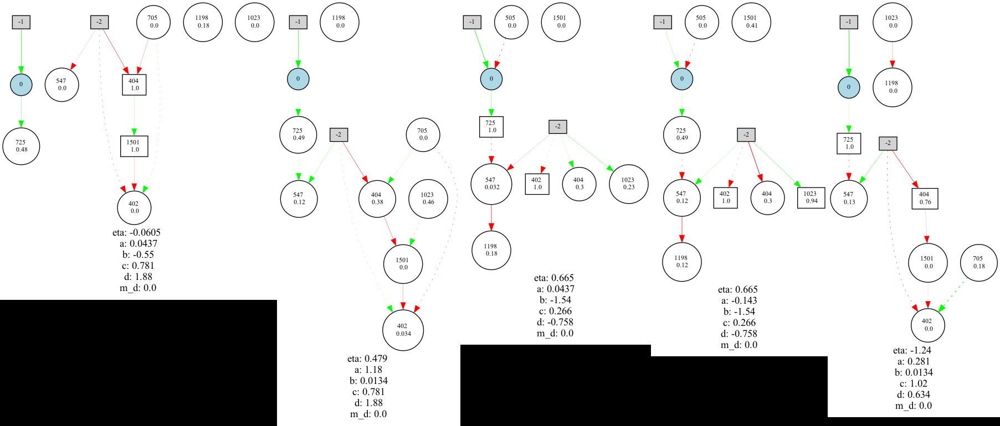

 >> species id:  3
 created:  0
 last improved:  55
[-3.368810275319789, -3.566856641619501, -5.6592393195986705, -5.8641425389113975, -6.0328257200698605, -6.118772662655463, -6.233897507713553, -6.346593808111627, -6.44366526346638, -6.452455292298912, -6.47650884342292, -6.592970692406279, -6.670025369135737, -6.779023746824105, -7.1110507013708535, -7.484313816028823, -7.5, -7.5, -7.831634513211041, -7.8706695109426805, -7.879504535091912, -7.913903665637574, -8.926412768287145, -8.927727303207435, -9.295558373446106, -9.489714077060103, -12.383966193956319, -13.182724154811869, -13.20935073165231, -13.418453429462575, -13.931787405945206, -16.85018111649542]
member_num:  32
best_fitness:  -3.368810275319789
median_fitness:  -7.5
worst_fitness:  -16.85018111649542
fitness_stddv:  3.1027463237498427
 number:  32


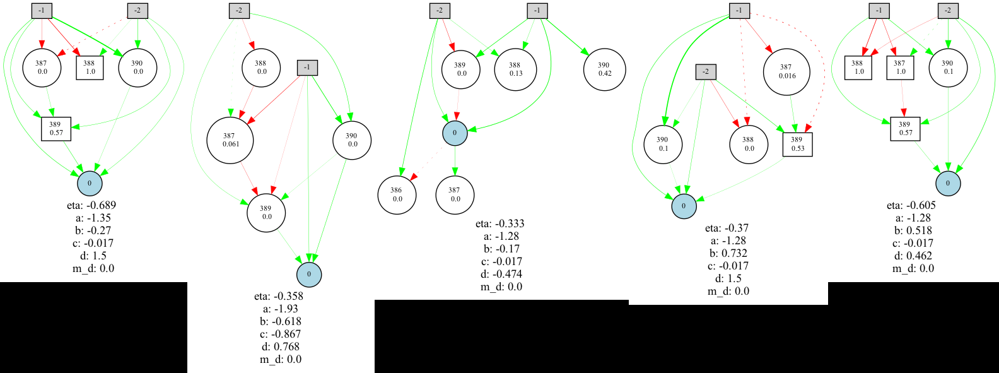

 >> species id:  5
 created:  3
 last improved:  49
[-1.5011498895059703, -3.013963943959244, -5.504205071429969, -5.712602774504264, -5.814269064755865, -6.184872579592362, -6.521303222907093, -6.562848368257217, -6.659887891247632, -6.688608552038208, -6.815700158226365, -6.87107804745494, -6.98462189015018, -7.578027682366671, -7.602617679998611, -7.833561028033248, -7.916804523419016, -7.939489327217814, -7.982885438598501, -8.001890941344831, -8.364753979505368, -8.566488975666315, -9.310369731887702, -9.716273638215572, -9.804024089618085, -10.064610437797281, -10.865137774201393, -13.232300390039708, -13.588519765886122, -14.403492003712419, -17.84033353587136, -17.86106998627404]
member_num:  32
best_fitness:  -1.5011498895059703
median_fitness:  -7.916804523419016
worst_fitness:  -17.86106998627404
fitness_stddv:  3.6084431033206106
 number:  32


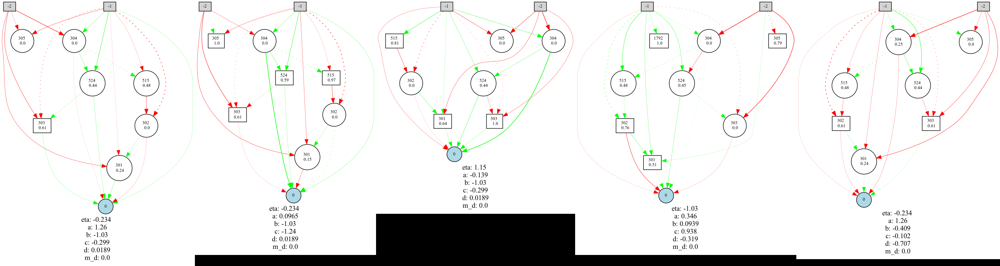

 >> species id:  2
 created:  0
 last improved:  67
[-2.6093236219264586, -3.3405732894583458, -5.2283889637663625, -5.744094300438232, -5.876834552010227, -6.056556637035907, -6.235110096705101, -6.250201447259829, -6.320182441171305, -6.486321535655108, -6.525640528690908, -6.6686313068289085, -6.704134649957706, -7.8833929066557555, -7.936370390232942, -7.960531743535854, -7.971621391164686, -8.21752519759894, -8.3991078171422, -8.457362602746118, -8.606577685027508, -9.253981619609776, -9.464151437458634, -9.576075758550656, -9.90738729670138, -10.153681055897586, -10.753541623078927, -11.627922939277171, -13.179820989646378, -13.527291098649712, -15.318204542312717, -15.662167583603097]
member_num:  32
best_fitness:  -2.6093236219264586
median_fitness:  -7.971621391164686
worst_fitness:  -15.662167583603097
fitness_stddv:  3.0584832370932986
 number:  32


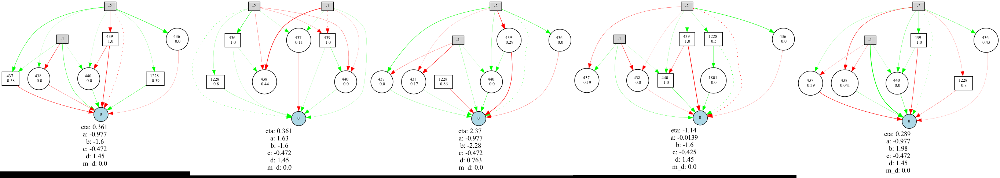

 >> species id:  1
 created:  0
 last improved:  68
[-2.3976273811160436, -3.167661840490593, -5.623186075163424, -5.768512456082011, -5.773784342089897, -5.946277774966915, -5.998178285852863, -6.093407695800694, -6.1325536329213515, -6.1738768914924025, -6.245011334529202, -6.329240401434706, -6.366479932261534, -6.558277914123758, -7.19142268462599, -7.5, -7.5, -7.583306899474075, -7.880402412988982, -7.904137020480628, -7.936713277379941, -8.19471470095311, -9.045540875982795, -9.438696105205528, -9.452533913534895, -9.520090466008169, -9.560340324403303, -9.956834686264886, -10.855508771107864, -13.356699946527282, -13.776819598909547, -13.828756911692107]
member_num:  32
best_fitness:  -2.3976273811160436
median_fitness:  -7.5
worst_fitness:  -13.828756911692107
fitness_stddv:  2.6491104264118626
 number:  32


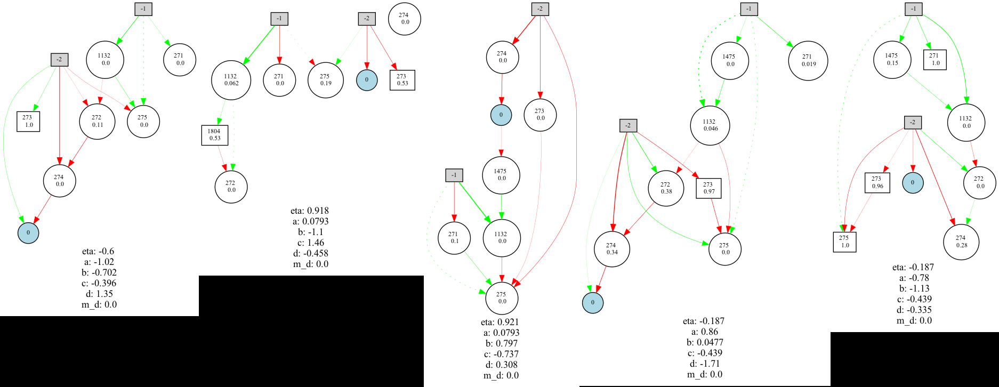

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-89
============================ infomation of  90 th generation ============================
dict_keys([3, 1, 2, 5])
 >> species id:  3
 created:  0
 last improved:  55
[-2.339416435452926, -3.3880134994610698, -3.901444514370122, -4.335571024361877, -4.579512243484473, -5.882852439833581, -5.982792808201402, -6.0669068361648995, -6.068191789216484, -6.081060394471292, -6.224161427124293, -6.310288034793295, -6.439952126326241, -6.5242499129378775, -6.5889339018531485, -6.610817832700626, -6.765894643018856, -7.19128920706256, -7.4876740719477075, -8.30041580264248, -9.642862281039303, -9.840058724449467, -10.237607849561257, -10.337157875011524, -12.09021937332666, -12.31376407162819, -12.594836150118727, -13.607976138722929, -13.879450955343433, -16.691755332505156, -16.806651472399718, -16.951273457530903]
member_num:  32
best_fitness:  -2.339416435452926
median_fitne

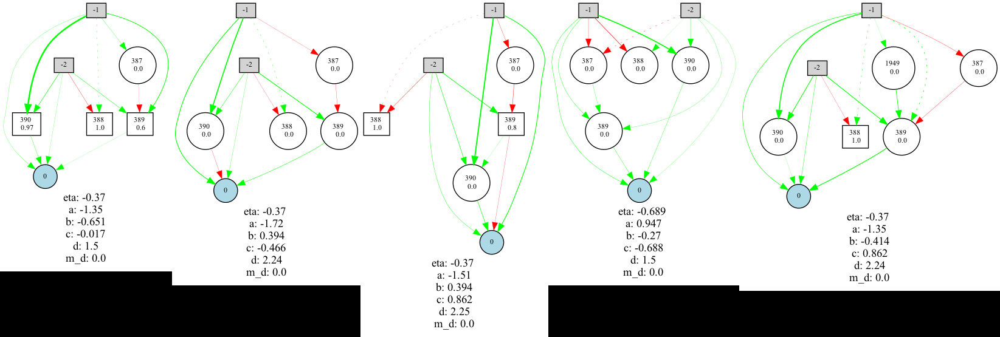

 >> species id:  1
 created:  0
 last improved:  68
[-2.397933166088282, -3.349404306924105, -5.457710556910453, -5.682144920748156, -5.907491612891026, -6.063098730919947, -6.095919689934251, -6.164523047890498, -6.3552755382425, -6.415580822577464, -6.597966447653237, -7.5, -7.500000000000001, -7.667988687554981, -7.769254997221522, -7.81796943770055, -7.828618684214522, -7.865500831252946, -7.927811307626956, -8.08206880489276, -8.212523769846797, -8.525002748259139, -8.556625749852353, -8.78607702967275, -9.096039582176465, -9.22020439949843, -9.28244065615252, -9.659318095821577, -9.672120075030247, -11.491269512313796, -13.966000628066688, -14.259631638077074]
member_num:  32
best_fitness:  -2.397933166088282
median_fitness:  -7.828618684214522
worst_fitness:  -14.259631638077074
fitness_stddv:  2.4447352483689646
 number:  32


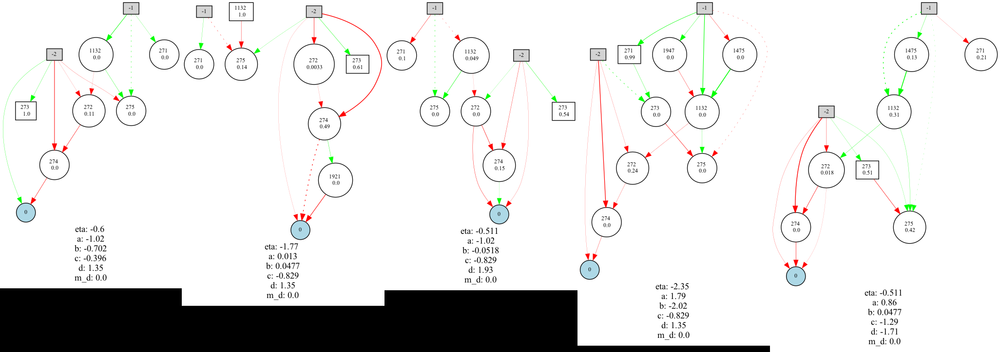

 >> species id:  2
 created:  0
 last improved:  67
[-2.1459970712250813, -2.2379937048834004, -5.880421899083334, -5.9141159035808535, -6.002729311264988, -6.05365002484567, -6.119232789474535, -6.124057655013509, -6.141721293258078, -6.172550968431704, -6.172550968616336, -6.183234263094419, -6.279069887560067, -6.282809138114126, -6.368081537195941, -6.3886263120014855, -6.517861386872328, -6.774865582245765, -6.830399625906831, -7.100859748616473, -7.162776930679213, -7.16453028647733, -7.5, -7.806898081415197, -7.855428621468865, -7.867398934356139, -8.109917458115513, -8.689160109928073, -8.963881158718728, -9.203843459452825, -9.744613851337418, -13.399057145304287]
member_num:  32
best_fitness:  -2.1459970712250813
median_fitness:  -6.517861386872328
worst_fitness:  -13.399057145304287
fitness_stddv:  1.9713462801857287
 number:  32


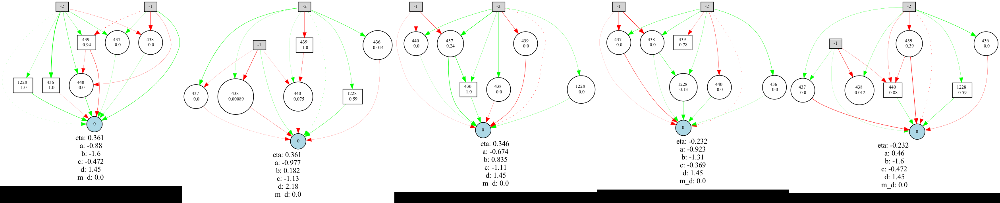

 >> species id:  5
 created:  3
 last improved:  79
[-2.2706934783359554, -3.0182123385153754, -5.587111297297785, -5.676144912197521, -5.727788664945213, -5.757516756588094, -6.121704686558626, -6.159997918455285, -6.363579366751666, -6.473677841983261, -6.589089680742398, -7.115261434714732, -7.5, -7.535252062664139, -7.545100115582738, -7.561093412100255, -7.608157185643181, -8.65571450674413, -9.158378910408565, -9.198962202922548, -9.361718350206615, -9.399626920658756, -9.457858865818322, -9.558202400925786, -9.845220726907563, -9.945971726920584, -10.086244497671638, -13.093204419497976, -13.679359338068366, -13.705323468843972, -16.94144809576077, -17.717493868167406]
member_num:  32
best_fitness:  -2.2706934783359554
median_fitness:  -7.608157185643181
worst_fitness:  -17.717493868167406
fitness_stddv:  3.4660527014062517
 number:  32


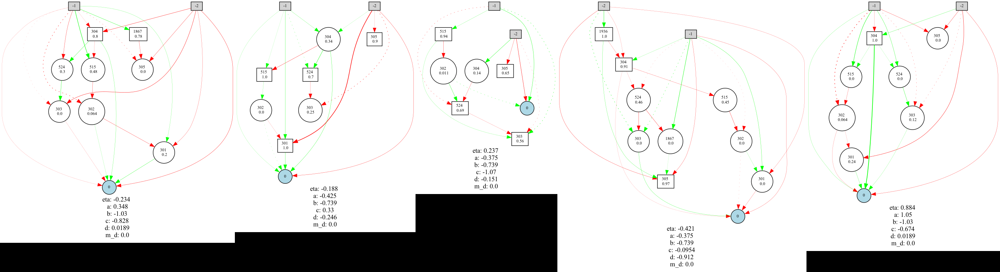

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-99
============================ infomation of  100 th generation ============================
dict_keys([3, 1, 2, 5])
 >> species id:  3
 created:  0
 last improved:  97
[-1.9863253490517054, -2.6516851180728427, -5.63283258038017, -5.6745326728419565, -5.964374049050963, -6.004831250719424, -6.192460973048338, -6.268749450485189, -6.290502215994811, -6.310105399887447, -6.585681330373796, -6.653591538250825, -6.76191643992153, -6.901658345205398, -7.078957176666661, -7.148864504599073, -7.22212914862633, -7.5175153043043546, -7.860186628906977, -8.48104213217346, -8.79529411727318, -8.808090403923053, -9.078053313601535, -9.19853705511471, -10.322253826827312, -10.793519207373118, -12.60781286387331, -12.836135997488313, -13.215879744743441, -13.372118046544632, -13.392921501306379, -13.64122870684201]
member_num:  32
best_fitness:  -1.9863253490517054
median_fitness:  

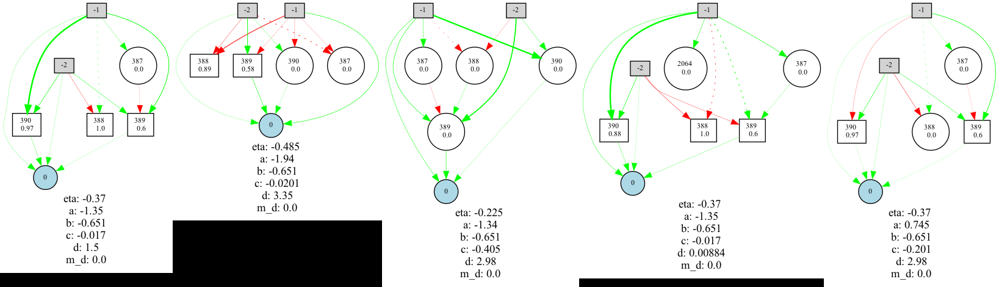

 >> species id:  1
 created:  0
 last improved:  68
[-2.2728119475988975, -3.1218740035216657, -5.95826066772148, -6.086580868249116, -6.128780022325624, -6.2441431218191585, -6.37591833660332, -6.400718815533287, -6.435638441351179, -6.468329143973711, -6.505592447495524, -6.521113280260083, -6.5232848719203504, -6.5486574199267515, -6.569050358656312, -6.656907527564283, -6.729564289325181, -7.172716450347529, -7.499999999999999, -7.509554979786277, -7.71560545345212, -7.72806948192379, -7.781873684509222, -7.811874199918405, -7.819177427673825, -7.891140070017165, -8.160183655665236, -9.282757830675619, -9.695888482227996, -10.402608029682954, -13.770624279473225, -14.554745503012562]
member_num:  32
best_fitness:  -2.2728119475988975
median_fitness:  -6.729564289325181
worst_fitness:  -14.554745503012562
fitness_stddv:  2.349611037706925
 number:  32


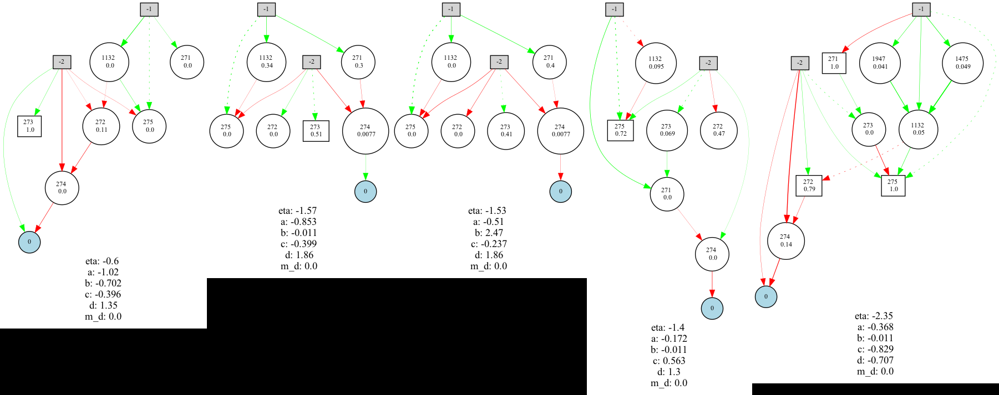

 >> species id:  2
 created:  0
 last improved:  67
[-2.518951025866172, -2.565923252084124, -4.722394654388244, -5.603414634847668, -6.176720923180726, -6.195814798136469, -6.241974386011866, -6.68379002530717, -6.759221665246399, -6.868203763409697, -7.2748187458069005, -7.5, -8.260405162431402, -8.333152429121517, -8.864958230605858, -9.063969836094596, -9.235661765237209, -9.428096225388845, -9.581475355207537, -9.735086931202579, -9.755368466403885, -9.972407785733443, -10.130356727419041, -10.710705372740442, -10.772857348781066, -11.861172958109472, -12.530941111444008, -12.53459471309722, -13.423992683693708, -13.50104666116989, -13.614762145320093, -13.735405690712943]
member_num:  32
best_fitness:  -2.518951025866172
median_fitness:  -9.235661765237209
worst_fitness:  -13.735405690712943
fitness_stddv:  3.027111843506681
 number:  32


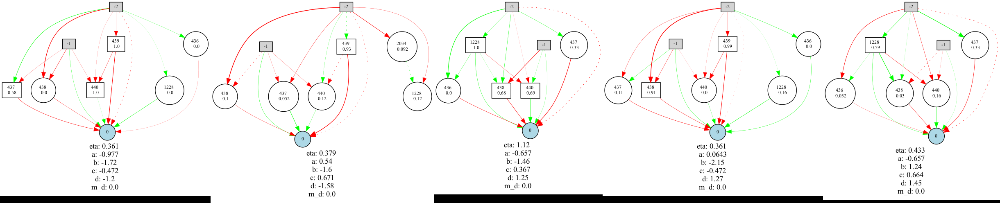

 >> species id:  5
 created:  3
 last improved:  91
[-1.8823568203413843, -3.0250397738242647, -5.039822393691361, -5.701210670897952, -5.765766394927839, -5.929737867478005, -5.949905409025809, -6.140804872306117, -6.296789165129176, -6.314570175217318, -6.4809103203788165, -6.506528448414083, -6.512715887191714, -6.553762771589439, -6.638265619920431, -6.656027206745753, -7.138801413124295, -7.15097758045788, -7.426460827486015, -7.5, -8.378247953208076, -8.943032759798227, -9.219329083609232, -9.79790783675564, -10.237595216918452, -10.278166183677142, -12.543150580939937, -13.057110757570923, -13.353252270640446, -13.372641681370286, -13.848112387420525, -17.657815253021997]
member_num:  32
best_fitness:  -1.8823568203413843
median_fitness:  -7.138801413124295
worst_fitness:  -17.657815253021997
fitness_stddv:  3.406484393967004
 number:  32


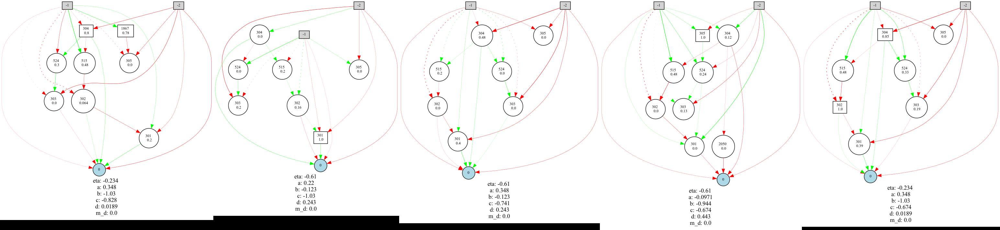

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-109
============================ infomation of  110 th generation ============================
dict_keys([2, 1, 5, 3])
 >> species id:  2
 created:  0
 last improved:  67
[-2.3718637349674765, -2.498391873046352, -4.457134902673857, -5.733603598864572, -5.948764188019236, -6.088034516081974, -6.107367330754725, -6.126287273484811, -6.232006250987926, -6.274099686741863, -6.309106203544127, -6.741108337819145, -6.909860165235432, -6.9197888183376906, -7.386179056966351, -7.84085992198173, -7.903158912680136, -7.934705905271079, -7.954882996757912, -8.485217958762325, -8.501799571350134, -9.34345540489453, -9.569283391225909, -9.706989321731756, -10.006537042070901, -11.196785961819309, -12.544570299927017, -13.033544968238019, -13.309083699790405, -13.53496039259537, -13.799605132506615, -13.992228083895078]
member_num:  32
best_fitness:  -2.3718637349674765
median_fitnes

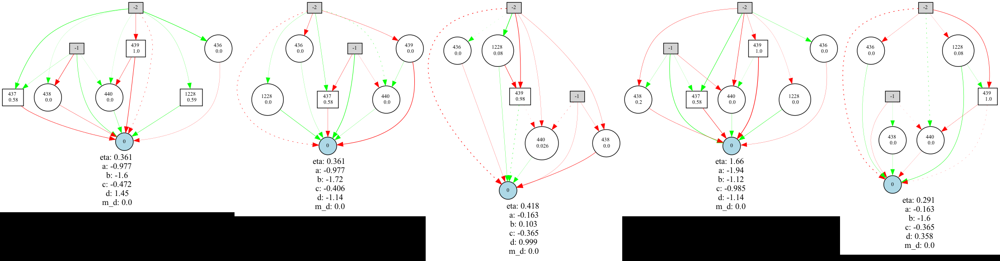

 >> species id:  1
 created:  0
 last improved:  68
[-2.415229828102924, -3.350562765636986, -4.084967498082318, -4.89261679495222, -6.030042912962109, -6.063717338698971, -6.0648088213711, -6.140288740806367, -6.150967578427366, -6.306111251872387, -6.395500399020037, -6.534464644768213, -7.5, -7.5, -7.650519174233349, -7.687546013550049, -7.788889792653315, -7.8357267593802025, -7.855244147653375, -7.88077832714283, -7.89280278091549, -9.57491786752917, -9.821063976380257, -10.988464745638176, -11.15437877539553, -12.54500165783163, -13.401234951367721, -13.466816168360406, -14.226533904357884, -14.339100806348071, -14.380693267163771, -14.441218172182117]
member_num:  32
best_fitness:  -2.415229828102924
median_fitness:  -7.788889792653315
worst_fitness:  -14.441218172182117
fitness_stddv:  3.4156109299894366
 number:  32


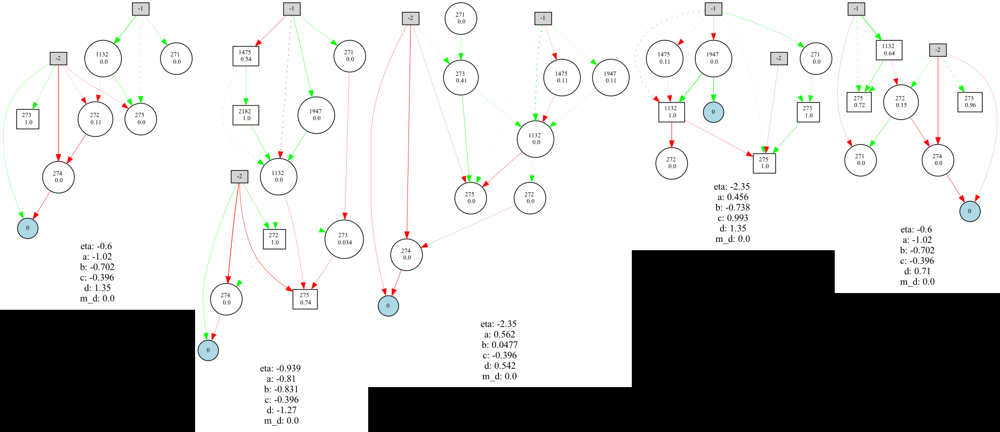

 >> species id:  5
 created:  3
 last improved:  91
[-1.515916728724394, -3.039006452074806, -4.385977226780065, -5.769926122529114, -5.945498094488194, -5.992328709803508, -6.228218566342772, -6.232322600611681, -6.260709043165905, -6.333970997266027, -6.4954611050119855, -6.6016968725569685, -6.756819962641134, -7.456957111465001, -7.888200904156605, -8.923254823590701, -9.02716458865147, -9.43617313975373, -10.144796566011822, -10.211705729695089, -10.760068487534083, -10.918136802016173, -11.718289182960591, -13.012750321875112, -13.149708297365116, -13.440336109415272, -13.573680553000056, -13.633461377460483, -13.677489219072388, -15.082949465984335, -16.507040854195054, -17.848895473559114]
member_num:  32
best_fitness:  -1.515916728724394
median_fitness:  -9.02716458865147
worst_fitness:  -17.848895473559114
fitness_stddv:  3.997070433492662
 number:  32


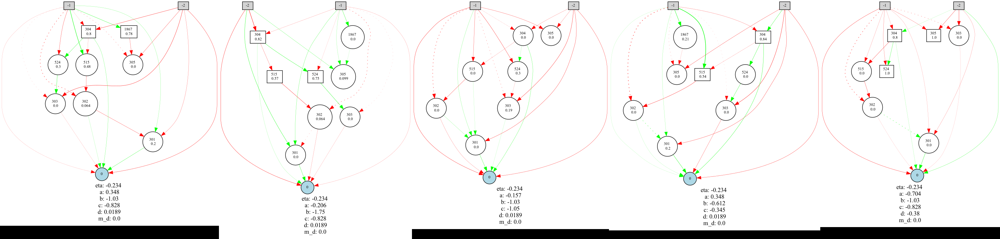

 >> species id:  3
 created:  0
 last improved:  97
[-2.1912942549263015, -2.256930025968288, -3.6800296507196517, -4.390187931398057, -5.767540238085889, -6.426158618551482, -6.47452493174859, -6.553303697632731, -6.771295436015939, -6.7929491232696755, -6.969226308769835, -6.982573225450603, -7.045205238318616, -7.1965301304473, -7.454138956836095, -7.567651851697722, -8.122998266929597, -8.486150066084317, -8.667748004450821, -9.00390852295953, -9.259304117944628, -9.422261225880309, -9.540319266942255, -11.024854783655197, -11.323732767055207, -12.042973386784649, -12.191798346757325, -12.800896591569597, -13.085966238888213, -13.258037585319325, -13.774147926823414, -16.531045111920744]
member_num:  32
best_fitness:  -2.1912942549263015
median_fitness:  -8.122998266929597
worst_fitness:  -16.531045111920744
fitness_stddv:  3.3735016312728168
 number:  32


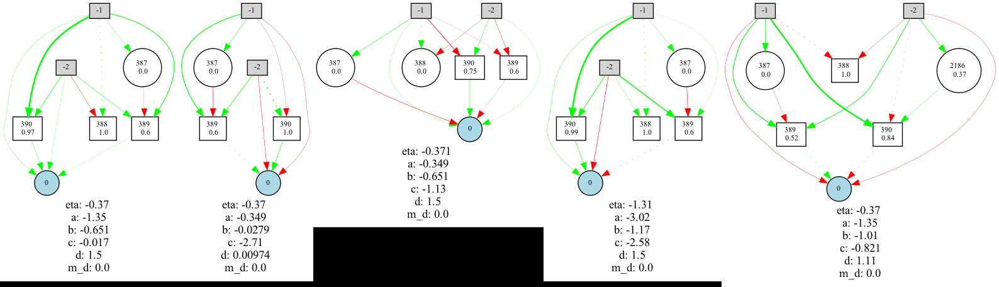

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-119
============================ infomation of  120 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.730558930463467, -2.254245250543593, -4.477979731250683, -5.2460943886172355, -5.438362768401891, -5.844784219537645, -6.039372685869617, -6.058884744794467, -6.0634523979456425, -6.127318938912566, -6.146120932408268, -6.164163806070758, -6.338270830271898, -6.344322476290151, -6.36349116315547, -6.486005943493511, -6.699119957346785, -6.715341524112671, -7.10895078704193, -7.289700814127844, -7.375079225216799, -7.5, -7.808019257230622, -7.81470031951832, -7.857642596197571, -7.8762178531158105, -7.959632910504441, -7.966003979697963, -8.624054522941703, -8.993055841818665, -9.076517725211687, -9.584689476390373, -9.773863473887792, -10.019080111931693, -10.031203064128805, -10.064257605715287, -10.227

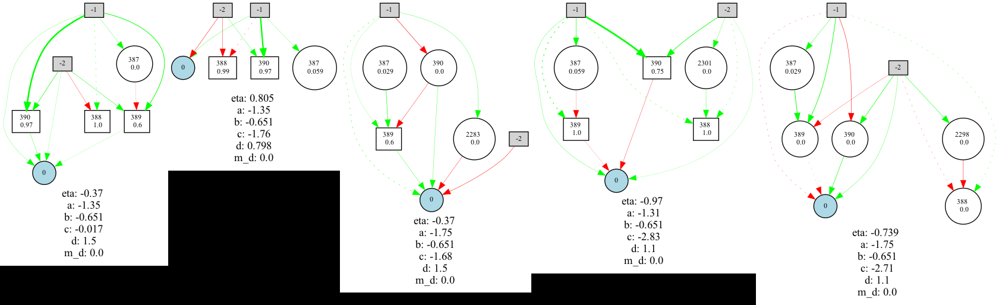

 >> species id:  5
 created:  3
 last improved:  111
[-1.6199646466976678, -2.8175469955686014, -5.620022545935487, -5.792656961677993, -5.9433416612976915, -5.976116581919449, -6.026072014007967, -6.060012209802463, -6.10567135683844, -6.283966329614672, -6.370526839294209, -6.395917559596109, -6.45748494528436, -6.465882849705774, -6.520960070487638, -6.547408075719213, -6.669254538841593, -6.687665730395583, -6.794597135782277, -6.840314037198184, -6.855168439907252, -6.860931005752238, -7.405181236037626, -7.5, -7.5, -7.5, -7.797042622969393, -7.910109718110423, -7.917029610714723, -7.96531295040474, -7.967434148236092, -8.255978383194849, -8.540068376004106, -8.897686973134734, -9.095938876370411, -9.170037670231604, -9.242701839040478, -9.378321868220624, -11.301820706464804, -11.917159658954695, -12.24566582193814, -13.0959801769215, -13.511795300891267, -13.521237263479861, -13.700429007129424, -14.893735117077814, -15.100467237301917, -15.447797891623166, -17.02826142428991, -

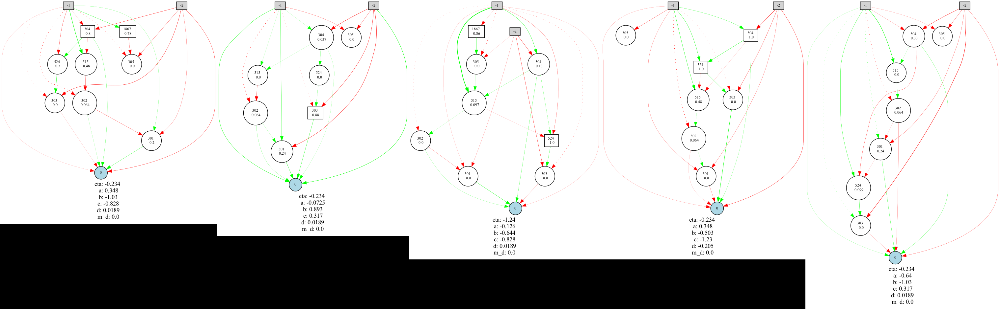

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-129
============================ infomation of  130 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.8572343358340935, -2.532690680013843, -5.393113654453069, -5.458239530774301, -5.899173865866893, -5.907301717415576, -5.917725929969686, -5.952258475243307, -5.954953933401041, -5.962149882812573, -6.107695613458127, -6.120696207318738, -6.129091980663961, -6.164303735732508, -6.1697102594952105, -6.171683039416614, -6.215463284410741, -6.255714377579115, -6.269299982550438, -6.303602531593151, -6.30753604090624, -6.315486135833911, -6.372363432107927, -6.416187186110916, -6.4312975937523955, -6.548240825781439, -6.565357220548554, -6.569854021209947, -6.57683270508227, -6.593476119596755, -6.675090432449853, -6.761868926454657, -6.8528624000204985, -6.861964744320362, -6.883057172894267, -7.5, -7.68566

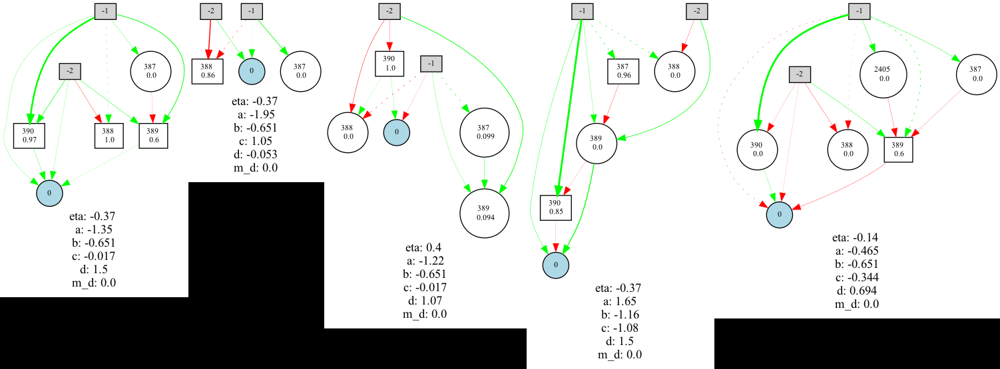

 >> species id:  5
 created:  3
 last improved:  111
[-2.4175497926163034, -3.0090325827744313, -5.621683009646549, -5.763086185490273, -5.888307067741746, -5.995862609304272, -6.031456307817249, -6.084235516415403, -6.088000850546849, -6.119958763508322, -6.1437864301836225, -6.170339692845433, -6.202366444303059, -6.2881716557942, -6.298148231894738, -6.362757233927124, -6.441263895113285, -6.476165379963304, -6.570589540461352, -6.575921866217745, -6.644534136072749, -6.820949132735454, -6.836231680813872, -6.904315656706587, -7.130909094188546, -7.1473844710423515, -7.5, -7.557354785296209, -7.832258169603369, -8.167168597119565, -8.168669796582112, -8.307173370609696, -9.621656360442447, -9.683011514033268, -9.786253847793056, -10.146027128446702, -11.037348321647407, -12.002383873654207, -12.23642894239783, -13.031248581931909, -13.304506039317175, -13.41097613890081, -13.515679182818914, -13.555324993304366, -13.74177797669652, -13.919977137183384, -16.47246984168263, -16.522614

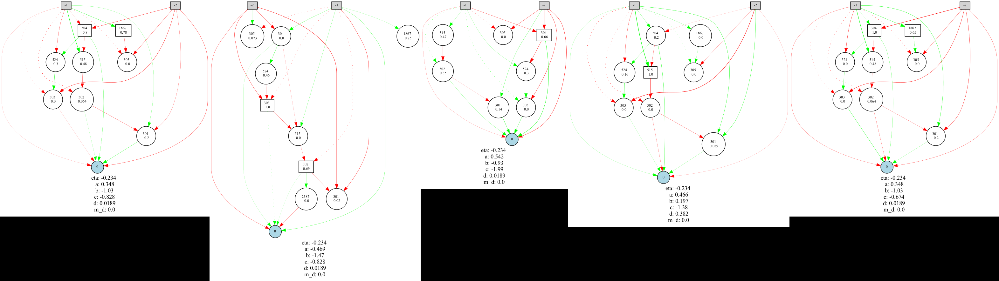

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-139
============================ infomation of  140 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.9775810031482173, -2.1395358103596416, -5.124416122673653, -5.3605057181047595, -5.524305607381976, -5.71606616724137, -5.773710509021711, -5.936167869154841, -6.073176471826718, -6.081371711726125, -6.11229879828415, -6.112515636317583, -6.134123121806219, -6.163118340495988, -6.16365227832056, -6.204179015497513, -6.273719567260171, -6.274711637635089, -6.325049688664744, -6.363105355502776, -6.364409579671234, -6.420938126440733, -6.476658958388363, -6.558008339668129, -6.628417112432773, -6.6719985026188295, -6.746444508622163, -6.8707132710629955, -7.008283523602241, -7.100963041454457, -7.163785040644443, -7.5, -7.619892885861387, -7.674560380711956, -7.698663662333763, -7.737756500192292, -7.74443

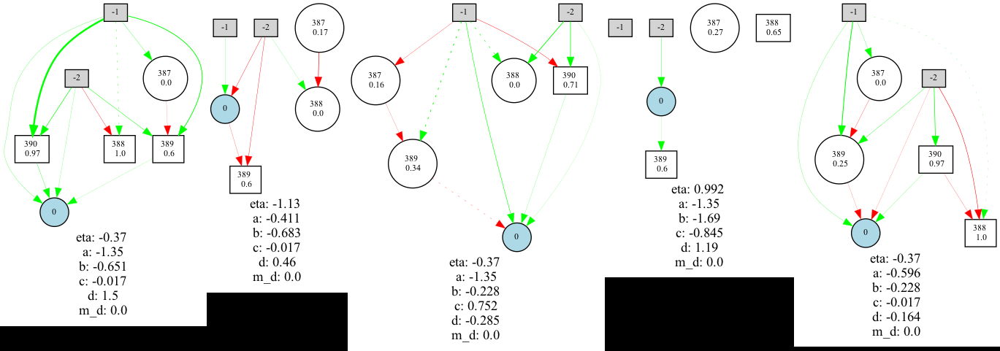

 >> species id:  5
 created:  3
 last improved:  111
[-2.5970854701359776, -2.8687198402074214, -4.283533525546183, -4.3105536270165015, -4.96977695407428, -5.643893952011152, -5.989080205568144, -6.014772982301899, -6.0563810251939145, -6.06279174292565, -6.073163523778974, -6.104073083832303, -6.110672714907997, -6.123912303498, -6.135533486132303, -6.2099969351827875, -6.2129382114827525, -6.216071293105971, -6.271416182421159, -6.276646922039397, -6.335296421928418, -6.357097083820938, -6.369371435944517, -6.374704592618967, -6.387132892390253, -6.40689379176392, -6.5090185289569416, -6.606416227997702, -6.694552789649572, -6.701253228853011, -6.774976260069569, -6.83413678852655, -6.941285633625134, -6.964127627822858, -7.090106207362052, -7.155076670816889, -7.3522112857089414, -7.500000000000001, -7.537387564347933, -7.806262850329576, -8.35969326167056, -9.610382106876065, -9.621333200230989, -9.633822935866514, -9.791070773121202, -13.459471182979309, -13.705203840977568, -15.

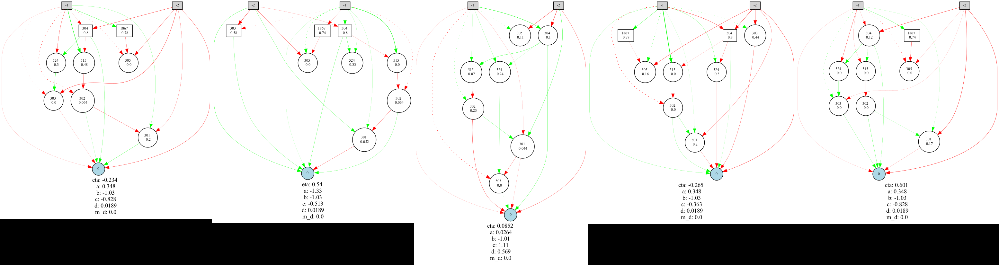

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-149
============================ infomation of  150 th generation ============================
dict_keys([5, 3])
 >> species id:  5
 created:  3
 last improved:  142
[-1.6389927171070044, -3.5835936110611626, -4.941131469642388, -5.687108052499206, -6.010385318873317, -6.067570869444664, -6.090788626608175, -6.102672773523553, -6.269448200709721, -6.274896580384384, -6.309881079379126, -6.354352319913503, -6.380259158613906, -6.445562283308743, -6.503618303223139, -6.533509546695129, -6.563212122898923, -6.668938883843189, -6.717668139792024, -7.0156927048728415, -7.372716266889099, -7.374179656747437, -7.5, -7.56867323762619, -7.628784344423432, -8.501132400456868, -8.711708698913965, -8.75801057040596, -8.840694103864097, -9.091969038719252, -9.380527874437627, -9.509188777187475, -9.664789502483186, -10.055581640299469, -10.118972872723464, -10.212484603337824, -10.44

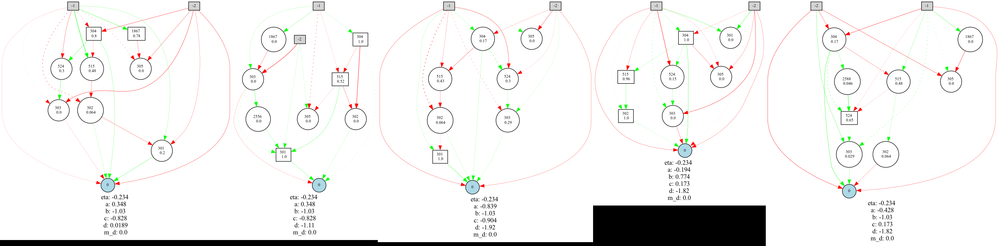

 >> species id:  3
 created:  0
 last improved:  115
[-1.943350690850927, -2.214696130285468, -4.007959402608524, -5.554671657205968, -5.644510593800563, -5.8285975243180586, -5.838489702206519, -5.954327499024581, -5.988906248667737, -6.020642144100172, -6.024413852654278, -6.087665149135377, -6.096753033818491, -6.276528465214262, -6.324767993706813, -6.374853941374093, -6.425280455060694, -6.4412145940599235, -6.499127130290059, -6.520647181857277, -6.6194115701851635, -6.791647637809154, -6.8128123090539505, -6.882463634465801, -6.926916469351222, -7.205883834293794, -7.5, -7.653052263307781, -7.7016184539092505, -7.75990713137706, -7.773999563687145, -7.936739244037428, -8.85195414699848, -8.962535352364114, -9.586363438983142, -9.66961493375704, -10.097470666564618, -10.62848785428763, -10.8792803725046, -11.20580065012857, -11.537021259690297, -12.439399110998906, -13.342868639000326, -13.391646979203315, -13.582429853421896, -13.627411072827451, -13.717399097547736, -13.7609873

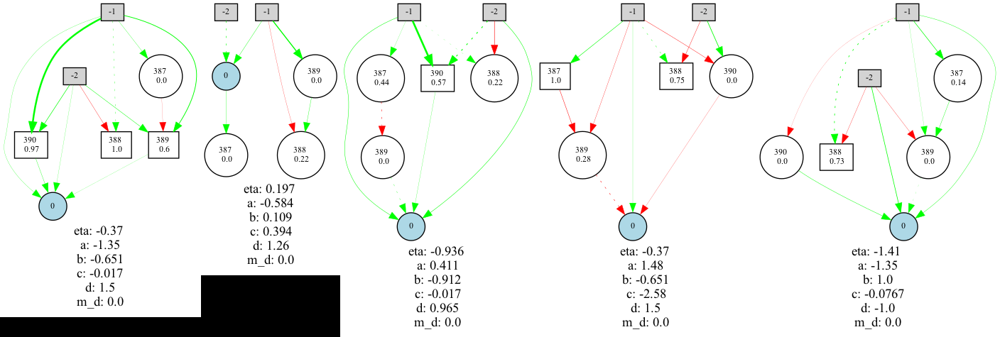

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-159
============================ infomation of  160 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-2.112109338356781, -2.2466759657872424, -5.529424805516036, -5.544541519845502, -5.8295672758325185, -5.9699503077631, -6.015162884325327, -6.032686155382367, -6.066212206572226, -6.068470735538632, -6.115550461057715, -6.194962117269591, -6.219721859665222, -6.265489322328938, -6.284585529116777, -6.317434065338583, -6.350732340143237, -6.374934384181024, -6.460210189915208, -6.460886829103227, -6.519067856559497, -6.528892483481487, -6.637210009595299, -6.71545608841211, -6.73320295257175, -6.87012166427446, -7.0624454620792445, -7.651565550417169, -7.680317340468998, -7.726577617952612, -7.776930073739938, -7.79248804854498, -7.837241313672187, -7.865219742081191, -9.945315264586128, -10.054575835459413

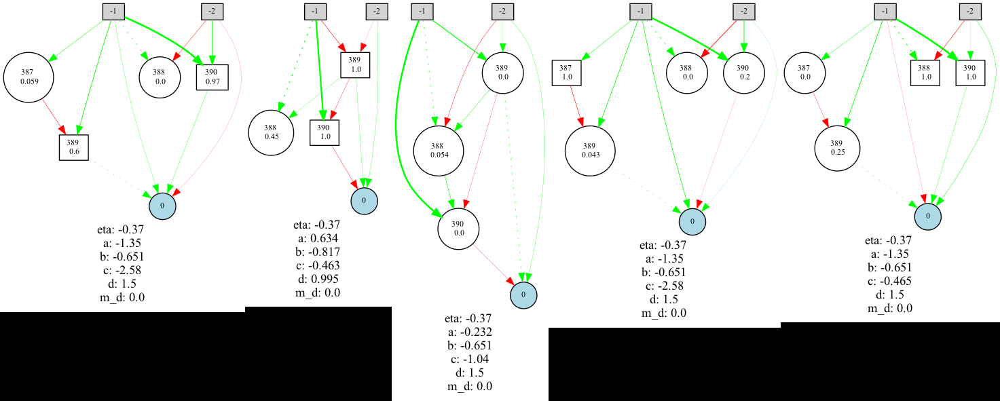

 >> species id:  5
 created:  3
 last improved:  142
[-2.7174301978003483, -3.7755874390440867, -5.39179205646794, -5.613961556467459, -5.7737774928568095, -6.042851909468248, -6.047651886146779, -6.04767797889307, -6.074836667931786, -6.08446480987891, -6.12789021747273, -6.135754256110454, -6.154829019570819, -6.198318600617568, -6.209887940878524, -6.313221575335413, -6.351608669658395, -6.395515850604458, -6.397701887356377, -6.4383933360006536, -6.442791601127085, -6.651920733240567, -7.278159560129934, -7.280202429185952, -7.5, -7.504000831099261, -7.639414888815547, -7.80658799150706, -7.822463788816553, -7.841509271731343, -7.912366686055639, -7.980838993588248, -8.49991461771905, -9.000101121568807, -9.143024574403261, -9.342052810814707, -9.826657226754879, -11.139210707377885, -11.524229115594622, -12.079232120900897, -12.850573943604033, -13.23455722532394, -13.545578429185188, -13.619009115553379, -13.640227413197154, -13.689729038774557, -13.69261671771087, -15.9342353389

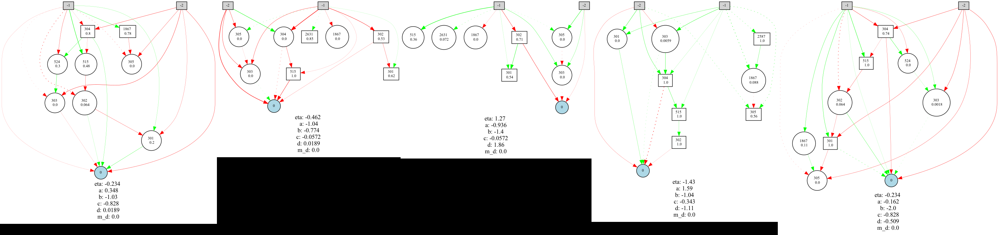

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-169
============================ infomation of  170 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.9315900929092573, -2.447832633301776, -5.440267687820452, -6.0253638143428265, -6.072345929377961, -6.083815734569441, -6.103667974907896, -6.140405495077243, -6.160497707514484, -6.1838833821613735, -6.199027759663428, -6.244283140363146, -6.284972063858601, -6.290937603211648, -6.307527208773374, -6.31520736685692, -6.3261533879885175, -6.34935812668612, -6.353825657110503, -6.397269875170055, -6.405640565552918, -6.426493115864066, -6.534100343923693, -6.539485802267443, -6.709202872417833, -6.933231915618684, -6.958466534586345, -6.991496946015243, -6.993477448071264, -7.349440801586389, -7.5, -7.5, -7.536701383000638, -7.629323827243404, -7.633928058678851, -7.7394161560753965, -7.828282365141454, -

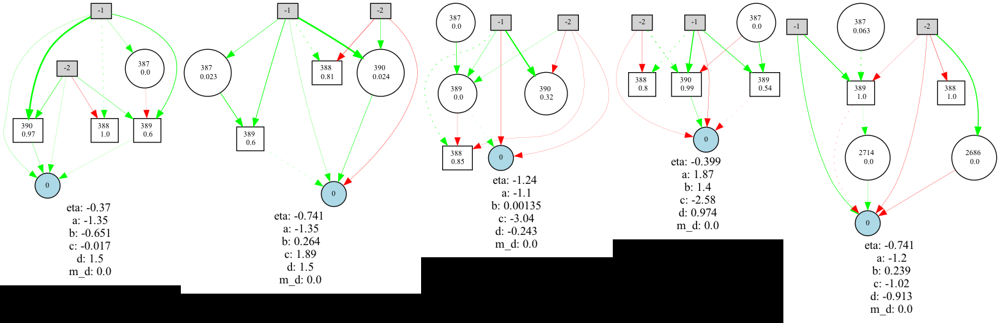

 >> species id:  5
 created:  3
 last improved:  142
[-2.024992529444308, -3.8373359721052713, -5.6393628903640955, -5.8398909835111485, -5.847354057661608, -5.9366403055472245, -6.104518218166089, -6.12980697247175, -6.148388453872687, -6.193265518991921, -6.21747990389329, -6.2578482831918985, -6.261768039936553, -6.284211974418287, -6.333662298112197, -6.428220787435225, -6.484579763599245, -6.845769934222628, -6.848326613824376, -7.024632150986411, -7.181440088487889, -7.318063956696936, -7.4685204643662155, -7.489470547995962, -7.499999999999999, -7.499999999999999, -7.5, -7.5, -7.573389932857458, -7.751407147697365, -7.759840810711525, -7.809881577664067, -7.822316617711488, -7.835760389420362, -7.9158774141078885, -8.020471788294339, -8.024295055932368, -9.236168785841684, -11.03714700089276, -12.333547620097558, -12.696534031614817, -13.050451362966308, -13.18054801367486, -13.418757564885272, -13.435958238802554, -13.4478646712651, -13.672527872013385, -13.93456920641859, -13.

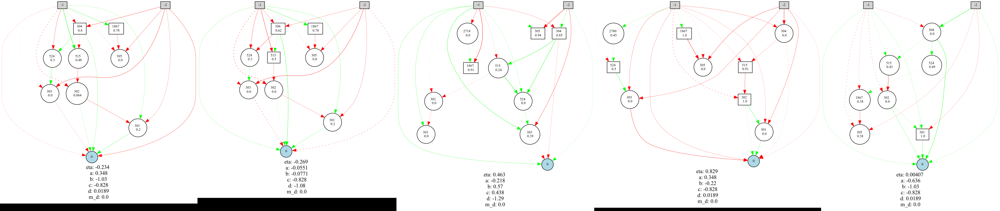

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-179
============================ infomation of  180 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.8089471823112124, -2.365067921157623, -5.202801923905507, -5.746325623440361, -5.750413912692738, -5.753640751292705, -5.796755046828778, -5.890670370473633, -5.922438250041167, -6.034036160731161, -6.057107337217596, -6.163344631934558, -6.2432637396578805, -6.286650469757199, -6.318930361642774, -6.469297830355774, -6.536007213371542, -6.550504653587724, -6.5592659008331715, -6.5785965362535, -6.582777197293602, -6.588260031569618, -6.631602505673891, -6.6662324491134894, -6.670935902616318, -6.850632565148265, -6.948332228898668, -7.153771727956337, -7.332624513065251, -7.438058301735333, -7.5, -7.5, -7.5, -7.500000000000001, -7.507426089576613, -7.545068412134361, -7.663178059066189, -7.7731409527911

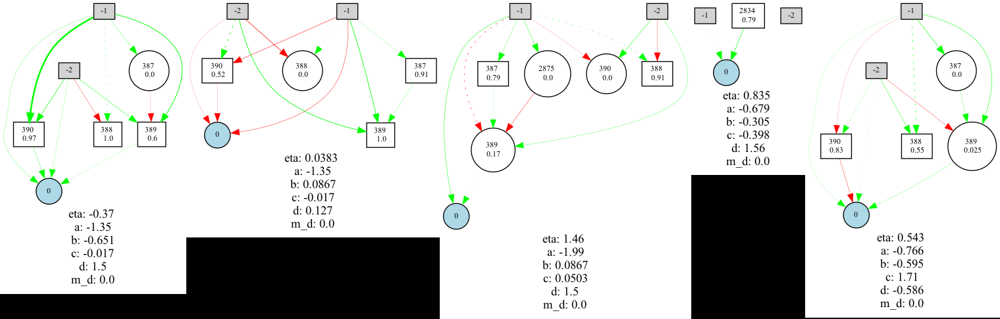

 >> species id:  5
 created:  3
 last improved:  142
[-1.8770447915961126, -3.3944339717628185, -5.567490882580496, -5.992423964067377, -5.992902363279036, -6.033129118249388, -6.038657805636547, -6.080077656759363, -6.173375025177735, -6.257630091009359, -6.303778438824472, -6.331377217401338, -6.3340587473835095, -6.374910750411718, -6.40327632156862, -6.418559431289503, -6.4310195352797415, -6.474374744076268, -6.494085605671586, -6.517228720127869, -6.5893092854816615, -6.625029376285815, -6.649582655340577, -6.835266369641046, -7.2090925046060015, -7.228071931255041, -7.336391880757488, -7.5, -7.5, -7.57915395334223, -7.7240804294745065, -7.771953288293034, -7.799672377664646, -7.8396122472714485, -7.843208177642061, -7.912397576630649, -8.160362529699384, -8.200631627447532, -9.571102532511054, -9.658139711198721, -11.313337653873958, -13.055810119863999, -13.626826882003282, -13.638009143031937, -13.775464049222961, -13.77959907267268, -13.783185053523797, -13.856595294652541, -

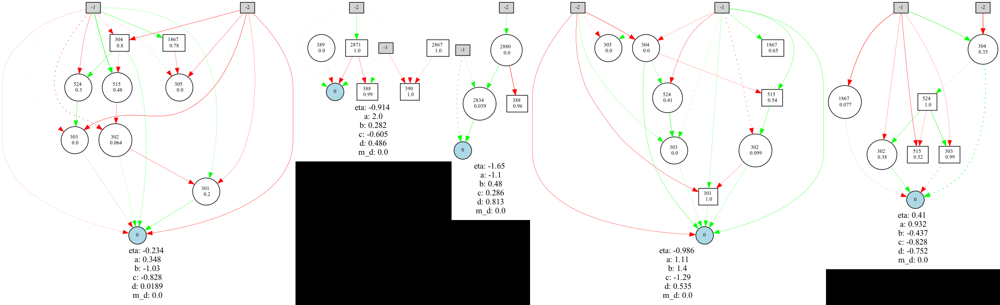

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-189
============================ infomation of  190 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-2.1784953890908723, -2.3955506951368646, -2.5800306778246953, -5.792881082435602, -5.88063622796694, -6.076862582687482, -6.079026086557848, -6.083055059659818, -6.091546636095871, -6.140472012581156, -6.157570948168645, -6.166228818601039, -6.176471151405501, -6.252547956612836, -6.261655603541337, -6.269769730223551, -6.2716117468595325, -6.289350589890811, -6.299588617680261, -6.471725090381193, -6.4915803117063, -6.50408805497136, -6.571195192128037, -6.603994401311777, -6.674629108982142, -6.724341972239001, -7.234310964080489, -7.36240793298194, -7.367635864880227, -7.713846287292477, -7.782801164181161, -7.82711352544068, -7.864375164957126, -7.879047882419663, -8.457297874553685, -8.986515221428302

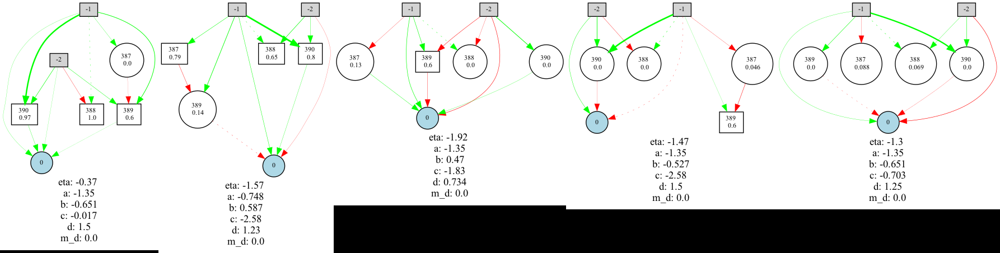

 >> species id:  5
 created:  3
 last improved:  142
[-1.4986422758742708, -3.5517719372398737, -4.761144287536384, -5.001828663732555, -5.483761557819788, -5.786178311807618, -5.831158121622861, -6.148898224443629, -6.168732116792808, -6.172263548288168, -6.179607225449565, -6.1839901414521945, -6.213223973128629, -6.3361447313133965, -6.368747180639898, -6.368919414851666, -6.4171415902459445, -6.464682081937099, -6.5119073228380575, -6.530068887706972, -6.544135305999899, -6.600906762088157, -6.625590712888529, -6.945498866238778, -6.969696720000668, -7.719082557876944, -7.865691952150924, -8.08438869719994, -8.442968284287112, -8.689971468318054, -8.784084860133595, -9.005355109923833, -9.05016855902963, -9.356787683507912, -9.656741155387982, -9.769544110598382, -10.254250404698372, -10.699408052165799, -12.07022411031752, -12.462780870420453, -12.89468541887887, -13.120907335479043, -13.139937023887626, -13.315443501158043, -13.412344629764691, -13.553658290220081, -13.8814571716

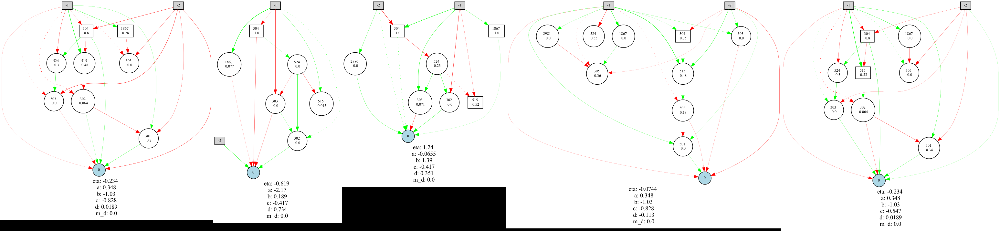

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-199
============================ infomation of  200 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.8130680491385458, -2.4345074525470123, -5.531163366015658, -5.588279099698307, -5.783641520645774, -5.983845480904533, -6.100086259604548, -6.1188449689394115, -6.128701123571901, -6.142310326428504, -6.167822164912157, -6.221903431968826, -6.231966164752757, -6.335883937194542, -6.3430516652469215, -6.36611076807784, -6.38760487969046, -6.395106506264681, -6.543655759806877, -6.5662616523645925, -6.803244503830519, -7.163596014611908, -7.3309292459851205, -7.499999999999999, -7.536260907046631, -7.590622472000628, -7.64042006236386, -7.671562373100955, -7.718599424872083, -7.753528258920762, -7.846390229149218, -7.896774182388908, -7.931055896318063, -9.201263113517879, -9.404813826995598, -9.4593430308

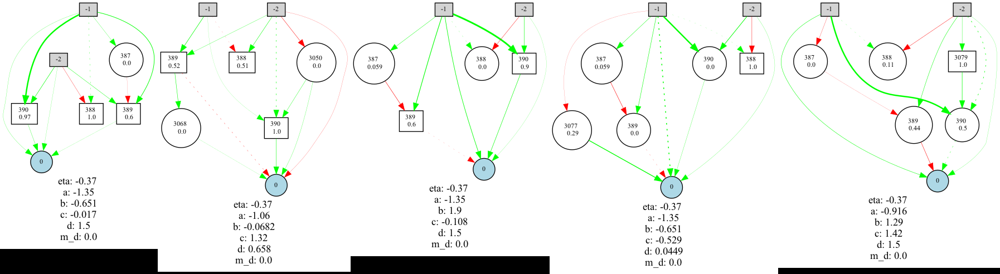

 >> species id:  5
 created:  3
 last improved:  142
[-1.888232986778379, -3.42598656264643, -5.734757762709555, -5.812399256576449, -5.834688721408087, -5.911582837376081, -5.924518394675295, -6.113039966583718, -6.172346001525027, -6.2185735633016685, -6.252956136756468, -6.253579291288913, -6.271136480476231, -6.3126420406328325, -6.343464723639447, -6.389840126184049, -6.429753348096275, -6.4477747994040655, -6.476469327585299, -6.5020193968869116, -6.525751518686307, -6.5472766858213065, -6.638455668573523, -6.670312425311515, -6.678222453459671, -6.70539555610761, -6.706886145530547, -6.848420880355427, -6.988426970056042, -7.1262644067255625, -7.371770942225983, -7.524457227225586, -7.561821523383004, -7.8007006593091965, -7.819804208114743, -7.848543604812767, -7.872772572592503, -7.892873718311595, -8.411045642672528, -8.871021943874544, -9.40041114962687, -9.56350049782899, -12.690389459527676, -13.229160920844187, -13.663981895765316, -13.667581014643684, -13.937922843916082

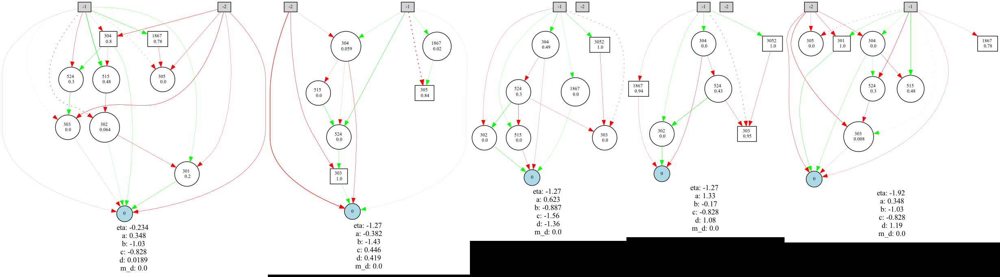

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-209
============================ infomation of  210 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-2.1274023720194255, -2.2361867099657453, -5.742310014551071, -5.953955936006096, -6.10207847737883, -6.1088311980147205, -6.1593157402525645, -6.2365900211874346, -6.255052333848584, -6.276622976948134, -6.283586741895626, -6.378471025810719, -6.422597063932249, -6.4520809161000585, -6.4726449395786005, -6.557407551871866, -6.5588123727111, -6.564363506898684, -6.622734638474214, -6.6289344890611135, -6.646692721839732, -6.683617897363124, -6.831713273262738, -6.913346495065344, -6.997468482076275, -7.261046406924281, -7.269157003707631, -7.5, -7.6522150932344, -7.748542075210417, -7.7968104012709984, -7.806514509122021, -7.843304073222095, -7.919422409128891, -8.664576148333794, -8.864260744037477, -9.111

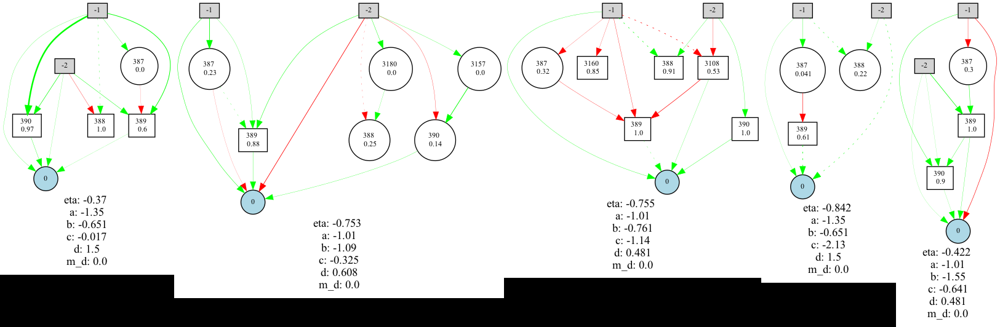

 >> species id:  5
 created:  3
 last improved:  142
[-2.083654343346014, -3.4499174378317345, -5.312088659048001, -5.4738349509903, -5.743465200341968, -5.743527882472964, -5.799562562375552, -5.9538580202403315, -6.053413480696496, -6.054341402011292, -6.063167829468253, -6.111734528837076, -6.11433623049075, -6.150286254686356, -6.169504740231533, -6.213926588276422, -6.313364642549725, -6.378579724023077, -6.4501036012596895, -6.490404853605172, -6.502954281248098, -6.540602248976537, -6.664027561112708, -6.711745888083717, -6.794622579627716, -7.029303648821422, -7.5, -7.5, -7.508451808074043, -7.755576030039748, -7.842496584281837, -7.85345992834769, -7.869742090682705, -7.9685716499759165, -7.998740227869309, -8.714522855914856, -9.264933171804584, -9.548114687114438, -9.681828551716405, -10.00991263432344, -10.948710539110127, -11.267261303006638, -11.876528989415412, -12.326280292838714, -12.896739001082553, -13.438989199102153, -13.538724437481678, -13.89132049395638, -17.131

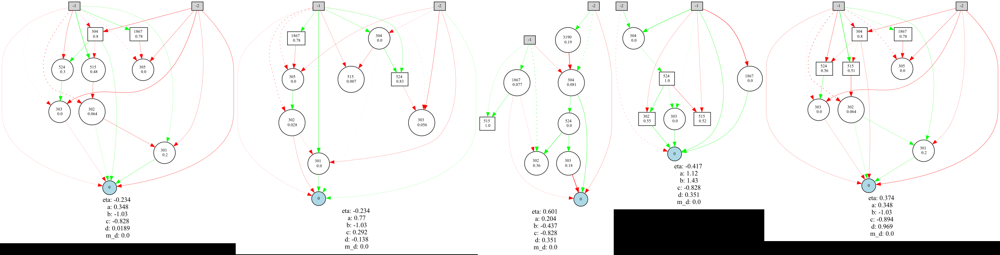

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-219
============================ infomation of  220 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  115
[-1.8563032968368671, -2.3794585469405187, -5.680718986518943, -5.866625157604105, -5.877406549910624, -5.95590776416945, -5.963827954427589, -5.988087679815355, -6.050608514219289, -6.0838664231593995, -6.103278797534603, -6.108658024874739, -6.1596789102808795, -6.209057375519604, -6.229758039661507, -6.33580151972172, -6.345034791792302, -6.452139928220441, -6.460198871717815, -6.466227087872507, -6.477127841947207, -6.516447483852296, -6.586252147086406, -6.6232227183040076, -6.6314931793629865, -6.682460546051843, -6.765482260160588, -7.200274267822964, -7.359478335579893, -7.5, -7.675935973805984, -7.791780854176714, -7.805559891107298, -7.853073978800971, -7.867070548904106, -7.9942542721310845, -7.99

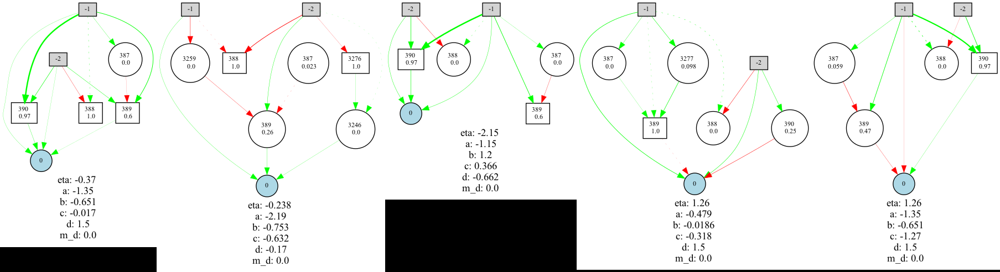

 >> species id:  5
 created:  3
 last improved:  142
[-2.168974110003603, -2.7956526285332783, -5.896600877893657, -5.938203453058081, -5.954580597252271, -5.971049211286516, -5.977906464285994, -6.003146330534632, -6.013533135312599, -6.1230324142457135, -6.141157085866142, -6.198325268261226, -6.220017494077803, -6.237442147126323, -6.251047172334618, -6.442430207377391, -6.465124117400635, -6.488791785474048, -6.518516601784913, -6.545217169973389, -6.570787084469471, -6.608617238535625, -6.669586375240325, -6.738836039981548, -6.948133000590187, -6.993692159242976, -7.065961028948863, -7.434400627089197, -7.5, -7.5, -7.732837520397188, -7.768699370605935, -7.853610927795453, -7.980991675891863, -8.069262957002325, -8.365291379338123, -9.07660191201693, -9.31890899934924, -9.372778545600143, -9.521142381333481, -9.608647883146684, -9.681270755357742, -10.051309949652032, -11.133171874283393, -11.763520889659384, -12.952795749450651, -13.075078101040505, -13.257041133869066, -13.2766

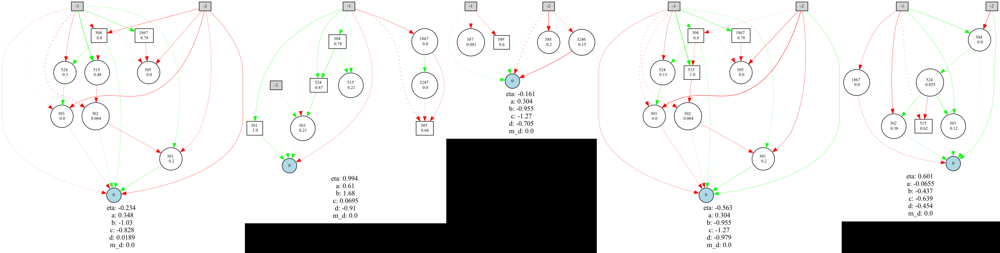

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-229
============================ infomation of  230 th generation ============================
dict_keys([5, 3])
 >> species id:  5
 created:  3
 last improved:  142
[-1.471316832281861, -3.3968802434693424, -5.590286341081587, -5.916794743199777, -5.966990270159683, -6.022534333495855, -6.026538247147625, -6.038583593561407, -6.038645892229531, -6.050114351580671, -6.056558297664462, -6.09905792104302, -6.132752424313885, -6.147711854854631, -6.174807245705156, -6.209240483196908, -6.2117303141252345, -6.241223100809665, -6.291132123274742, -6.296937892166631, -6.330856300372261, -6.352375655799516, -6.4011436834336335, -6.402947305144693, -6.40562077531741, -6.529681404526436, -6.602632988510173, -6.6390748370086925, -6.6512254828137, -6.956318244722642, -7.102304289027675, -7.31036219034584, -7.5, -7.790220829329469, -7.811753638861243, -7.820089406397332, -7.87639090

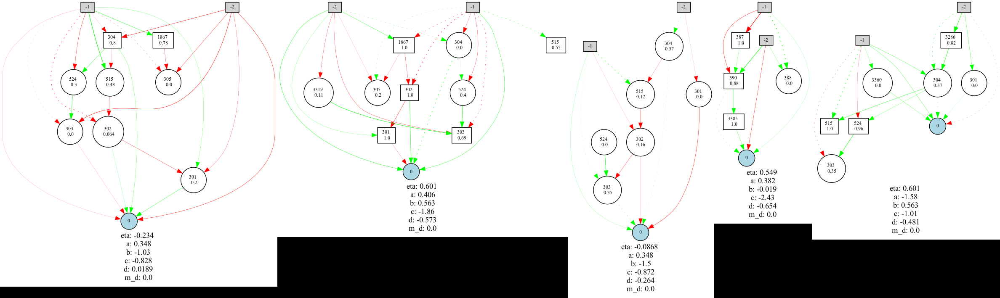

 >> species id:  3
 created:  0
 last improved:  115
[-1.9788110035745186, -2.174255509874093, -5.230728241381789, -5.775195342844123, -5.866617982636646, -5.99329611110645, -6.027192064813862, -6.1111874269682085, -6.151317256725007, -6.210498413791913, -6.257415481674494, -6.311467245592843, -6.374044859911479, -6.374842972347275, -6.470983885518563, -6.520624341081761, -6.547979174796141, -7.176557019909703, -7.208940257136097, -7.290409440735299, -7.295843056795082, -7.5, -7.500000000000001, -7.5199141576139565, -7.678268823430007, -7.711005314952997, -7.732609901759565, -8.082647765060814, -8.088201371994806, -8.110813207966592, -8.248657940545757, -8.427080638483687, -8.473126653344583, -9.107787398351388, -9.193790203850975, -9.244494869220953, -9.301331127525296, -9.303839721738512, -9.50292018303317, -9.58364880760684, -9.604087763191602, -11.753771550667778, -12.916801111811928, -13.656103612977706, -13.786751381884201, -16.13951595671892, -17.638783680583295]
member_num:  47

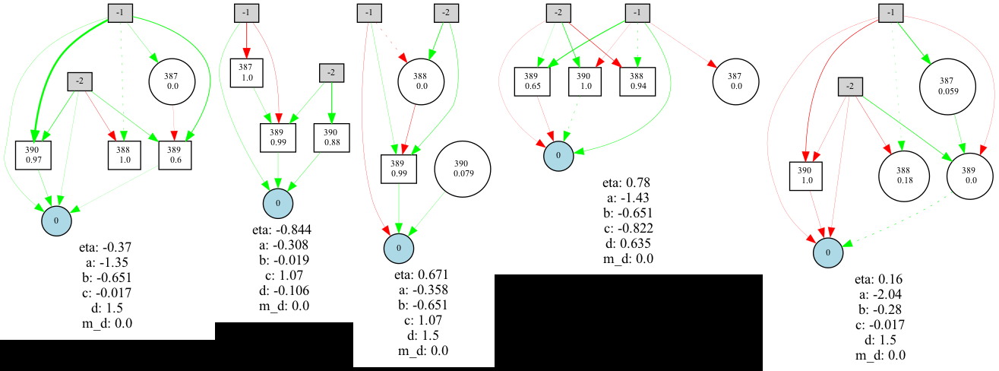

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-239
============================ infomation of  240 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  234
[-1.3807122269285859, -2.0775784085633155, -5.769104855229354, -5.797681791575673, -6.043611401208931, -6.088035218016337, -6.1018429847726345, -6.112788052403536, -6.148965388867456, -6.179144999236903, -6.210560727212481, -6.22860621934427, -6.244295352264154, -6.255631871239133, -6.274221735907059, -6.291647429307978, -6.3261319596367205, -6.338078091964585, -6.376894166346537, -6.384786170943178, -6.423120978896666, -6.478631029086593, -6.480631939054665, -6.554839213163928, -6.6360053965569685, -6.688160453630367, -6.749756284803256, -6.812474892519881, -6.820864306514746, -7.062651463140376, -7.144701345961188, -7.292637059028095, -7.5, -7.5, -7.762594908234352, -7.819181039097991, -7.872461492736377, 

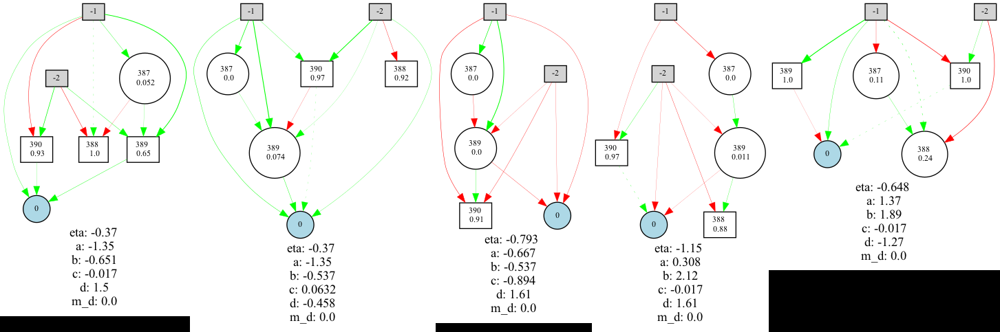

 >> species id:  5
 created:  3
 last improved:  142
[-2.1338881495029876, -3.4051947684747543, -5.486907093897128, -5.595601846542548, -5.928133675003267, -5.966340760031585, -5.993293876303665, -6.016581079848416, -6.054679110642365, -6.073695811052128, -6.083593358824387, -6.096367671040209, -6.105051277771589, -6.188209096668059, -6.18870271013929, -6.302899370655654, -6.33901337286677, -6.383288962664815, -6.3998277963744785, -6.463352564102109, -6.47616080290936, -6.524634555996048, -6.566320611466957, -6.5892777324945575, -6.603767379521676, -6.735748006385196, -6.854470242733014, -7.500000000000001, -7.561863108928745, -7.660151498922877, -7.758754220094922, -7.763270452357251, -7.765024544574571, -7.813422914135308, -7.84056105844072, -7.841163391534717, -7.885975384048167, -7.912712624147302, -7.968853173711208, -7.992020100270963, -8.738665414841714, -9.26050651916215, -12.892361691293168, -13.319585713998459, -13.618237257982916, -13.648676733382617, -13.659794020260609, -1

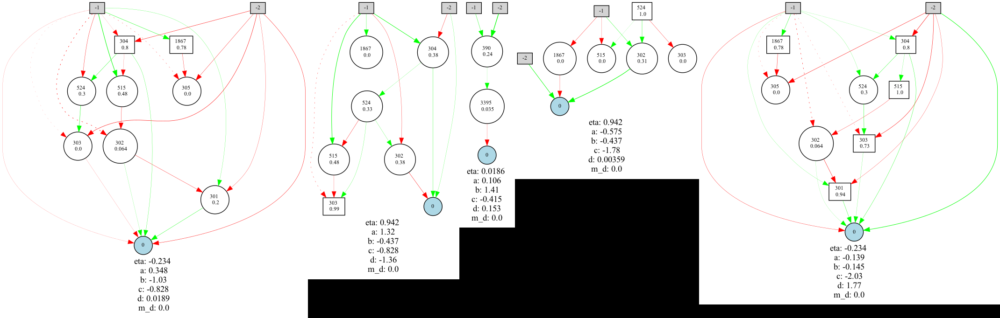

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-249
============================ infomation of  250 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  234
[-1.8448889963725583, -2.116157592390775, -5.709524655791805, -5.956956494107832, -6.116786916041285, -6.120547202477426, -6.1764568074076935, -6.258818284393368, -6.332469766370018, -6.355314550779246, -6.400568141736363, -6.40588364626396, -6.499474726175445, -6.640616402871116, -6.772871086888067, -6.906255694913123, -6.986345971207195, -7.410317306759579, -7.5, -7.5, -7.5, -7.500000000000001, -7.631390846875516, -7.706365535112527, -7.78137070204164, -7.800835115811173, -7.8390816521705124, -7.847479731690572, -7.923423627482937, -9.437052166922658, -9.553152597941635, -9.961409508987344, -10.540268155657822, -10.656159189986516, -10.838191857128603, -11.47538367650239, -11.799313880255623, -13.173615930

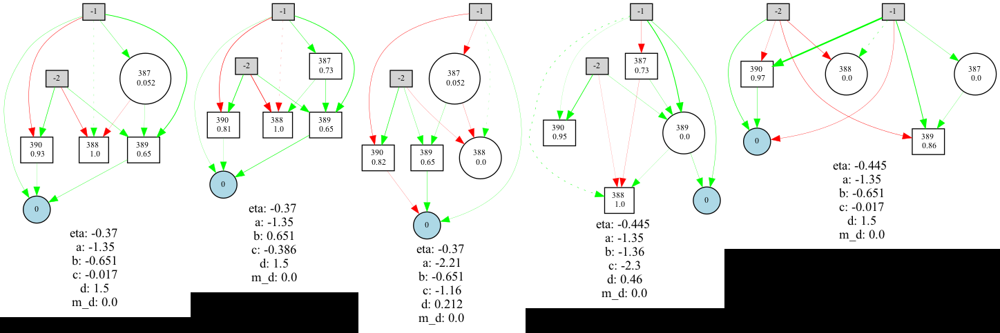

 >> species id:  5
 created:  3
 last improved:  142
[-2.2113112281606133, -2.6369517756149223, -4.197867527869091, -5.268684738413604, -5.663625333859118, -5.691526954667909, -5.8520994722946975, -5.910817628481603, -5.942981549507179, -6.028422600192616, -6.091054033315426, -6.117894873457978, -6.195921643903091, -6.212154143315589, -6.225821842637024, -6.285148939971008, -6.326727978627499, -6.356102483472439, -6.429608602548747, -6.5428882359421126, -6.544725316827838, -6.575838778761358, -6.6041855203487705, -6.628140341888403, -6.667507812633865, -6.687831732861997, -6.7918029617364715, -6.825564503028225, -7.023245656486606, -7.0839180471941035, -7.5, -7.5, -7.500000000000001, -7.581667287839393, -7.830448398427393, -7.8904409472303865, -7.919378895632159, -7.944074425540446, -7.967192325767999, -8.45643499065667, -9.065370209698395, -9.220094886874008, -9.239969600698746, -9.274361097510972, -9.498806917020495, -9.562667577980589, -12.29227820932427, -12.885298446488623, -12.95

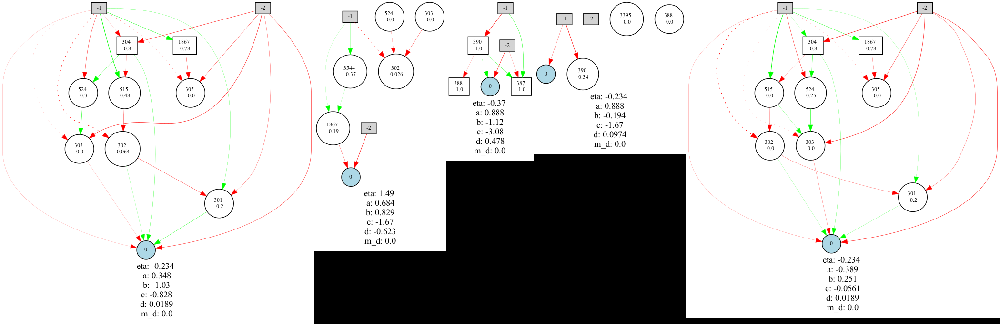

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-259
============================ infomation of  260 th generation ============================
dict_keys([5, 3])
 >> species id:  5
 created:  3
 last improved:  142
[-2.215797428840535, -2.4508586413471054, -3.518620277462794, -5.365351218822161, -5.403031905418418, -5.935122745845421, -6.033461964942527, -6.0436896284889885, -6.070979949708196, -6.080833066012765, -6.15777913403169, -6.186767006955546, -6.201127056318075, -6.311623639889159, -6.479084185299668, -6.5886195951309645, -6.69527997844925, -6.820947146575922, -6.861731992461032, -6.963181182986295, -7.011952142030035, -7.488301870464342, -7.5, -7.5, -7.5, -7.500000000000001, -7.714332621457965, -7.721679077687785, -7.7484783364567065, -7.757899136873076, -7.760710776531028, -7.8606480229736455, -7.862108817305883, -7.883288823857128, -7.892686239172978, -8.294496311912642, -8.801903410202927, -8.965755410087

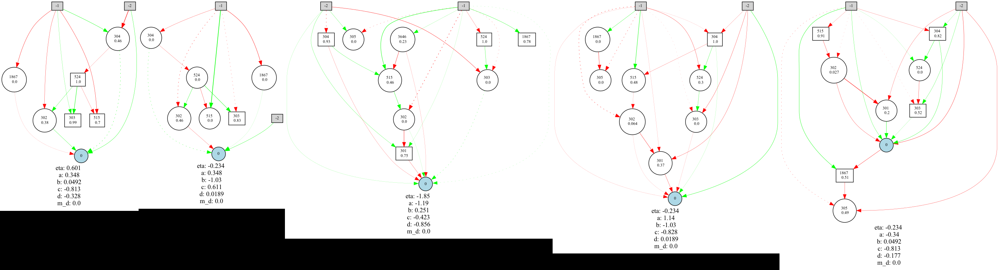

 >> species id:  3
 created:  0
 last improved:  234
[-1.978002959183389, -1.9855819824224434, -2.3198913658223947, -4.99189687785985, -5.782639332533515, -5.8206687909179315, -6.124662556163213, -6.148920180031472, -6.15602875819342, -6.202917033114364, -6.2070715309384745, -6.248504256226486, -6.257258722632962, -6.275999157473206, -6.299571464652237, -6.309042703701883, -6.358703096001601, -6.3602506556660865, -6.62769733950808, -6.6922765605003605, -6.699123266877358, -6.717371083496239, -6.872983907243084, -7.323369903088368, -7.5, -7.5636034323500425, -7.657786335475456, -7.709095214909883, -7.807700440008309, -7.9743334012206395, -8.548377506479454, -9.404553706085212, -9.458642895756649, -10.092420200920708, -10.606377409426196, -11.404348310156095, -11.432286652665029, -11.554568234627071, -12.783395139178186, -13.284251711070908, -13.394364156692728, -13.608926665592058, -13.61205532322426, -13.636332431643318, -13.801284848354824, -13.857466815168204, -14.591480549406937, -1

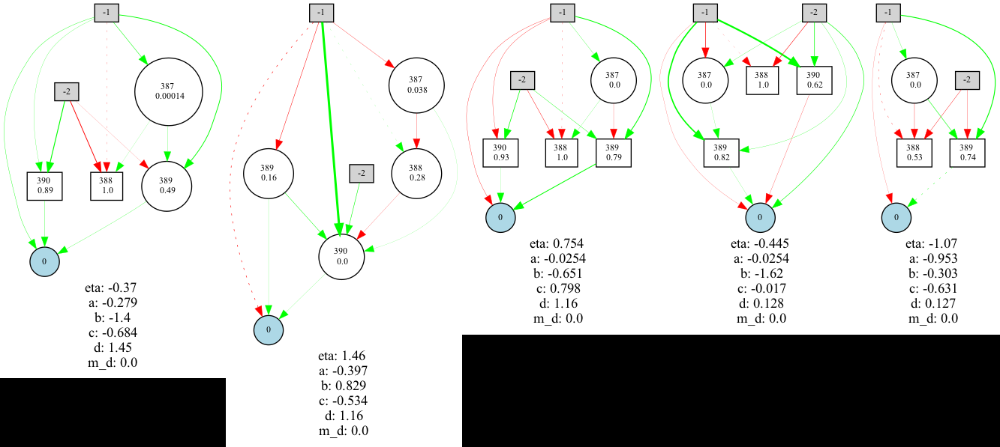

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-269
============================ infomation of  270 th generation ============================
dict_keys([5, 3])
 >> species id:  5
 created:  3
 last improved:  142
[-2.2194624062553436, -2.6733474624450917, -5.380540290409925, -5.960938467013299, -6.041507280603155, -6.062050449872414, -6.160416637322781, -6.163091526538239, -6.217731262067903, -6.229663982809224, -6.241134619452557, -6.273335941771631, -6.273948741933823, -6.290144267522114, -6.306503209619904, -6.325234979650324, -6.4995662063300195, -6.6034479922590155, -6.6289617711947715, -6.6790624942548105, -6.703938883441171, -6.788439468468077, -6.789081202366837, -6.795968752297747, -6.969648193366112, -7.282259957750713, -7.5, -7.5, -7.761105649800188, -7.764557922060522, -7.8210028571981285, -7.827150469482098, -7.923984368717273, -7.952282733911875, -7.978444866108128, -7.985589622611909, -8.35757646479243

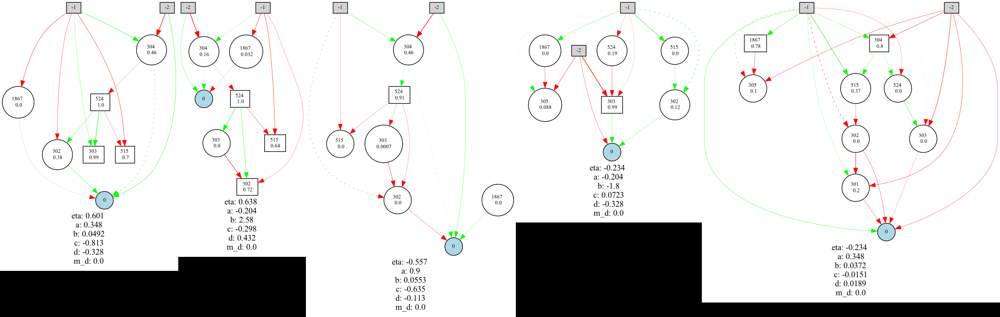

 >> species id:  3
 created:  0
 last improved:  234
[-2.1385422548377804, -2.3997822159236004, -5.508457971955394, -5.748318498405028, -5.910397902721661, -5.94857837370479, -5.9656216470163175, -5.983751673135492, -6.025156981613506, -6.038890449971402, -6.067091252407259, -6.104563554736425, -6.175502758712067, -6.256003156262283, -6.266288291582747, -6.298119930988333, -6.405224347949843, -6.420122200417875, -6.459849071512725, -6.528775363338008, -6.5805494658868895, -6.6368528195099925, -6.738645570770132, -6.745833551127526, -6.7867269306014055, -6.80001386515903, -6.903401957701317, -7.210933301795481, -7.232625392727458, -7.275405919854737, -7.380546169326857, -7.4878689570149595, -7.5, -7.501105342643014, -7.737057948154086, -7.765678377416151, -7.770612675009171, -7.878378758295578, -7.9124460047709615, -8.542675178043547, -9.294206491716311, -9.479217778247518, -9.55117404471703, -11.070512544831512, -13.663551708624192]
member_num:  45
best_fitness:  -2.1385422548377804
me

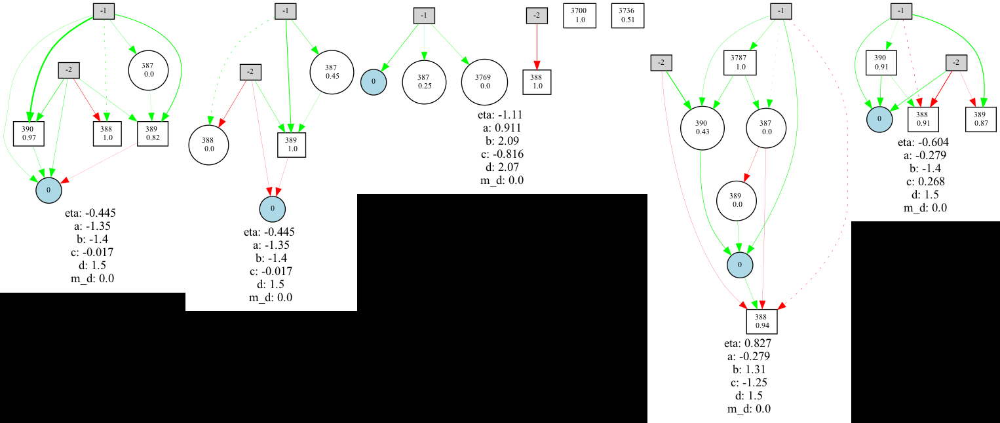

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-279
============================ infomation of  280 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  234
[-2.0590406490304, -2.203007851211018, -5.67063730513293, -5.679061073049011, -5.838563974000484, -5.963649593169741, -5.995603637317943, -6.032908388443496, -6.067774259465419, -6.205330535441435, -6.2934282196602, -6.339020516564101, -6.457086281870476, -6.480672398968144, -6.564430063201154, -6.621675067675198, -6.64365491591715, -6.6742443577062955, -6.6832168638298075, -6.837020318526784, -7.082561317896848, -7.181800420119766, -7.311718015032011, -7.532947036685295, -8.015745728589234, -8.296090714789822, -8.332119271689402, -8.416799718161032, -8.942094019161324, -9.150280242541486, -10.056092421967456, -11.062997508540844, -12.182064676257617, -12.747021051436752, -12.838513204707985, -12.87929461359

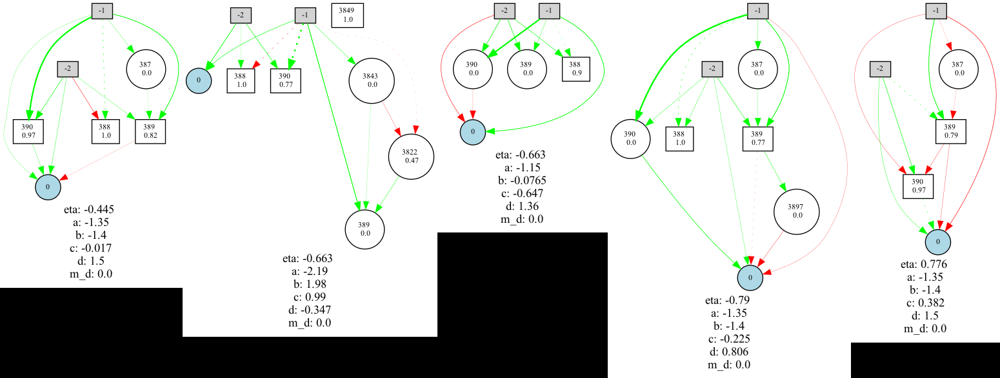

 >> species id:  5
 created:  3
 last improved:  142
[-1.745399369750664, -2.3713364164316175, -5.7375386990531725, -5.789468089563714, -5.897203975131449, -5.908472259805174, -5.92317443187535, -5.926349817636814, -5.983174090135799, -5.9915670120430065, -6.193069591805989, -6.251089517910459, -6.4661601851706285, -6.530900400509686, -6.531945799091581, -6.540207918199521, -6.660015624123099, -6.6616939819323395, -6.690182437344856, -6.705074614368241, -6.763113790137733, -6.893402208908295, -7.023647105571928, -7.118576655308064, -7.121595512648719, -7.234506823632395, -7.5, -7.508344614131101, -7.599942351667057, -7.695908073146481, -7.740188575218831, -7.797577941860731, -7.858126049553035, -7.858584054595511, -7.8834559662081105, -8.700667670099206, -9.034617650169505, -9.1203852080994, -9.151164558840875, -9.588119731873086, -9.829065252411533, -10.722085652235492, -12.441412578057513, -12.482356205367584, -12.75061207490847, -12.763492101518564, -13.504470273780756, -13.55051665

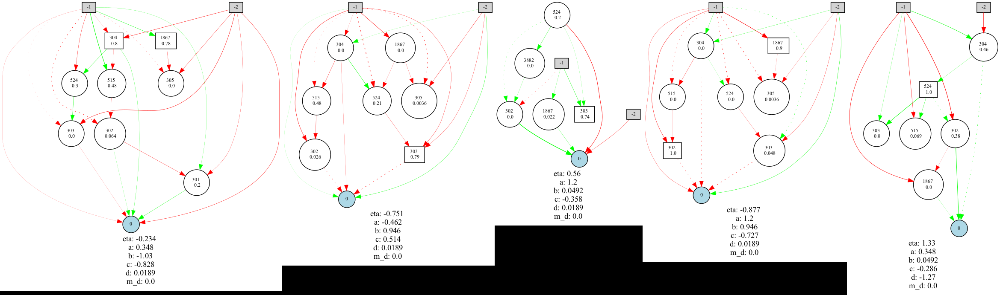

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-289
============================ infomation of  290 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  234
[-1.8557357665237146, -2.276616420140318, -5.511179106079078, -5.768514401849965, -5.835427238723209, -5.83574039051347, -5.987224860338213, -6.00092276052311, -6.041169281991923, -6.114426853995053, -6.143123605316044, -6.160774737483481, -6.1841967788092145, -6.272156585511809, -6.324646841683704, -6.3824821403735585, -6.403506308982034, -6.477493205998593, -6.590666154657474, -6.6540868961635, -6.6592611508936566, -6.742058784669577, -6.8731176774532585, -7.058524416701329, -7.283540794680389, -7.472899489674886, -7.52183289435707, -7.64804324570939, -7.714371859038743, -7.881226184958819, -8.303397854711609, -8.530870914199808, -8.566001535822366, -8.699791778295703, -9.017385976771145, -9.22725011447330

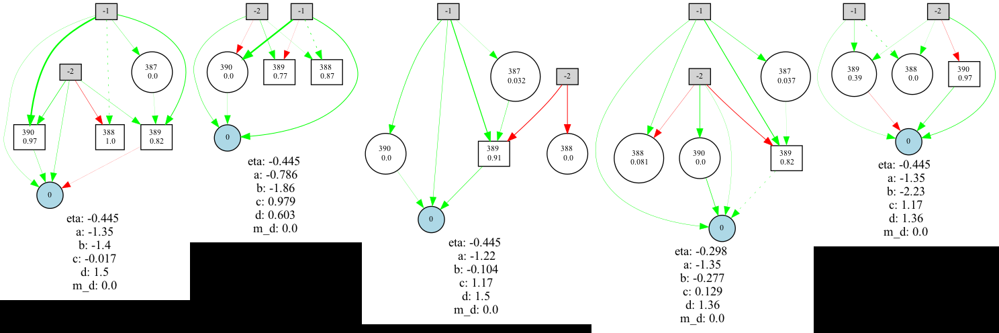

 >> species id:  5
 created:  3
 last improved:  142
[-2.4164851859452603, -2.6851083662296356, -4.921296499643901, -5.789285474346121, -6.01705263312632, -6.049107748570928, -6.099668718783378, -6.101411277094127, -6.113931424350244, -6.1208909961705045, -6.126339822788507, -6.1280293908102745, -6.151882655287358, -6.1691629212237595, -6.1780369542073155, -6.180379286559319, -6.4060334414228866, -6.41263825681744, -6.4431628023240215, -6.451998884065651, -6.476967774437969, -6.4929244527176495, -6.544983289093957, -6.557999937965149, -6.582971321086174, -6.589180770334183, -6.59560554183299, -6.700048303748713, -6.947886603272687, -7.064475117655312, -7.2781026154853325, -7.292501593470311, -7.3427614652326145, -7.5, -7.503649211934757, -7.538508280835806, -7.773969051272433, -7.875461875090828, -7.898832947940429, -7.9747791759380995, -9.459701620774092, -9.819458116400114, -11.239678560860982, -11.656138855478423, -12.496810858099328, -13.159605788275318, -13.55066040649723, -13.576

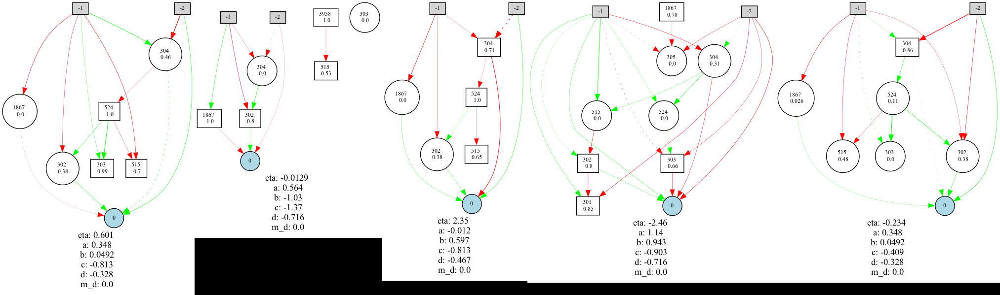

/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints/checkpoint-299
============================ infomation of  300 th generation ============================
dict_keys([3, 5])
 >> species id:  3
 created:  0
 last improved:  234
[-1.7746758378720953, -2.025935381890172, -5.239539721408821, -5.3912168204015, -5.5926977577336245, -5.802705821151524, -5.909256066753745, -5.987713629675784, -5.993690270618316, -6.0530679516684875, -6.062315868379981, -6.179537469165358, -6.197408120084654, -6.197621818645843, -6.259429955609644, -6.26714543260643, -6.400063828364312, -6.427045739623243, -6.475605857469019, -6.500148013448011, -6.504084078487887, -6.627954769575624, -6.6967760615074, -6.938734565914295, -6.9806174228881535, -7.011908689457301, -7.120606860504741, -7.523773306819234, -7.766504680782687, -7.77446908664715, -7.837275428312994, -7.883452876175922, -7.939040279083314, -8.361477248706727, -8.413312721660311, -9.16764338636614,

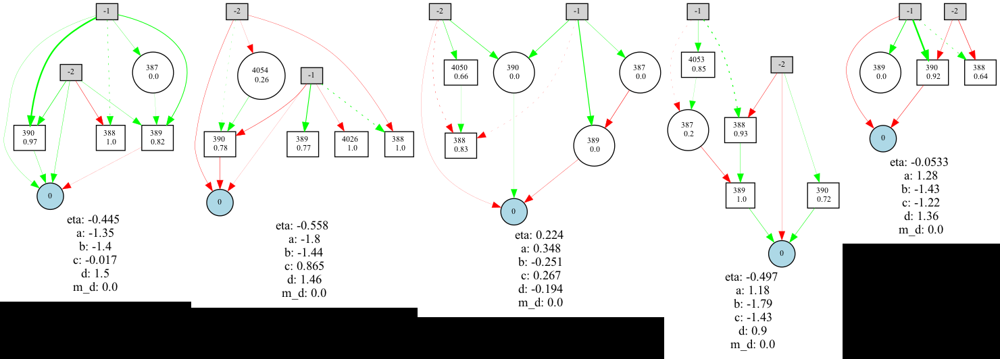

 >> species id:  5
 created:  3
 last improved:  142
[-2.480790069280658, -2.6329200237925705, -5.688381211226802, -5.74910988839512, -5.862028091983955, -5.9001773951332135, -6.082397495269488, -6.109900663926923, -6.184874260697414, -6.1895693475196225, -6.19870860134971, -6.283823630774665, -6.381838136963974, -6.42738994547574, -6.4727701300157, -6.503695588871469, -6.5378606168089295, -6.543041506040497, -6.608148831779966, -6.669596574764304, -6.673522236215587, -6.6844358314717445, -6.712443662857675, -6.72924310615935, -6.7483142569786585, -6.773407400438396, -6.93461624589802, -6.952420221990243, -6.99532684789667, -7.223264656894164, -7.243865535852465, -7.367545968878483, -7.5, -7.5, -7.500000000000001, -7.66764751610017, -7.715130724248462, -7.765537326660712, -7.767635259540779, -7.782146715435322, -7.857794464038352, -7.929343211077935, -8.140596406923894, -8.92412565949982, -12.22251617255522, -12.656734993189389, -13.387763959697526, -13.584389346739037, -13.65741224602

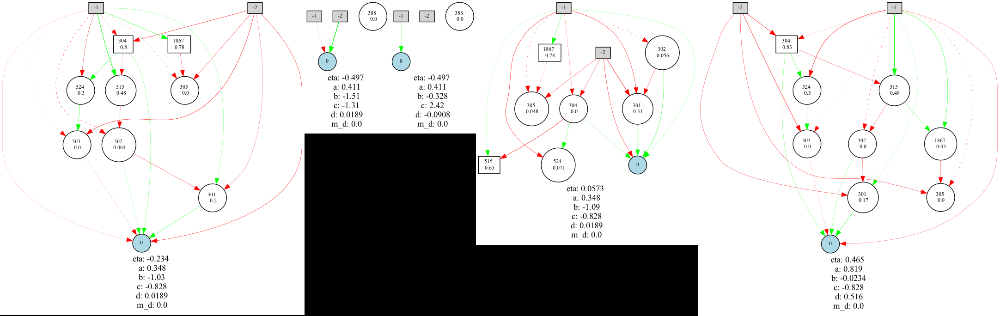

In [7]:
# checkpoints/ディレクトリを指定
checkpoint_dir = '/Users/mahiro/Project/modneat-python/tmp_test_learning/results/test_learning_ModExHebbFFN_201/checkpoints'

interval = 1
cnt=0

#チェックポイント内のcheckpointのパスを取得
for checkpoint in sorted(os.listdir(checkpoint_dir), key=lambda x: int(x.split('-')[-1])):
    if cnt%interval==0:
        # checkpointのパスを取得
        checkpoint_path = os.path.join(checkpoint_dir, checkpoint)
        investigate_checkpoint(checkpoint_path, is_display=True)
    cnt+=1